# YOLO mit Daten Augmentation und noFlood images und mit freezing von Backbone

In [11]:
notebook_title = "yolo_data_augmented_tuner_freezeBB"

In [12]:
import os
#os.environ.pop('MPLBACKEND', None)
import cv2
import numpy as np
from glob import glob
import matplotlib.pyplot as plt
from PIL import Image

Daten laden mit Data Augmentation

*muss nur 1 mal gemacht werden*

In [13]:
#%run ./utils/load_data_with_augmentation_yolo.ipynb

```
Wrote 2890 label files to /home/aie3/christina/dataset/yolo/augmented/labels

--- content of a random label file img_0725.txt ---
0 0.0 0.5633333333333334 0.0 0.68 0.005 0.6866666666666666 0.0075 0.6866666666666666 0.01 0.69 0.0125 0.6866666666666666 0.015 0.6866666666666666 0.0175 0.69 0.0225 0.69 0.0325 0.7033333333333334 0.0375 0.7033333333333334 0.04 0.7066666666666667 0.045 0.7066666666666667 0.0525 0.7166666666666667 0.0525 0.72 0.055 0.72 0.0625 0.73 0.0625 0.7333333333333333 0.065 0.7333333333333333 0.0725 0.7433333333333333 0.0725 0.7466666666666667 0.075 0.7466666666666667 0.0825 0.7566666666666667 0.0825 0.76 0.1 0.7833333333333333 0.1 0.7866666666666666 0.1025 0.7866666666666666 0.1075 0.7933333333333333 0.1075 0.7966666666666666 0.115 0.8066666666666666 0.115 0.8133333333333334 0.1225 0.8233333333333334 0.125 0.8233333333333334 0.1275 0.8266666666666667 0.1325 0.8266666666666667 0.1425 0.84 0.145 0.84 0.1525 0.85 0.1525 0.8533333333333334 0.16 0.8633333333333333 0.16 0.8733333333333333 0.1625 0.8766666666666667 0.1625 0.88 0.165 0.88 0.1675 0.8833333333333333 0.17 0.8833333333333333 0.1775 0.8933333333333333 0.1775 0.8966666666666666 0.1975 0.9233333333333333 0.21 0.9233333333333333 0.2125 0.9266666666666666 0.2125 0.93 0.215 0.9333333333333333 0.2225 0.9333333333333333 0.225 0.9366666666666666 0.2275 0.9366666666666666 0.23 0.94 0.2325 0.94 0.2375 0.9466666666666667 0.2375 0.95 0.24 0.9533333333333334 0.2425 0.9533333333333334 0.245 0.9566666666666667 0.245 0.9633333333333334 0.2475 0.9666666666666667 0.2475 0.97 0.25 0.9733333333333334 0.25 0.9766666666666667 0.2525 0.98 0.255 0.98 0.2575 0.9833333333333333 0.2625 0.9833333333333333 0.265 0.9866666666666667 0.265 0.9966666666666667 0.3075 0.9966666666666667 0.31 0.9933333333333333 0.31 0.99 0.315 0.9833333333333333 0.315 0.98 0.3175 0.9766666666666667 0.3175 0.9733333333333334 0.3225 0.9666666666666667 0.325 0.9666666666666667 0.3275 0.9633333333333334 0.33 0.9633333333333334 0.335 0.9566666666666667 0.335 0.9533333333333334 0.3375 0.95 0.3375 0.9433333333333334 0.35 0.9266666666666666 0.3525 0.9266666666666666 0.36 0.9166666666666666 0.3825 0.9166666666666666 0.385 0.9133333333333333 0.3875 0.9133333333333333 0.39 0.91 0.39 0.9066666666666666 0.3925 0.9033333333333333 0.3925 0.9 0.395 0.8966666666666666 0.3975 0.8966666666666666 0.405 0.8866666666666667 0.415 0.8866666666666667 0.4175 0.8833333333333333 0.4175 0.87 0.415 0.8666666666666667 0.415 0.86 0.4125 0.8566666666666667 0.4125 0.85 0.4075 0.8433333333333334 0.4075 0.8366666666666667 0.405 0.8333333333333334 0.405 0.83 0.4025 0.8266666666666667 0.4025 0.8133333333333334 0.4 0.81 0.3975 0.81 0.3925 0.8033333333333333 0.3925 0.8 0.39 0.7966666666666666 0.3875 0.7966666666666666 0.385 0.7933333333333333 0.3825 0.7933333333333333 0.3775 0.7866666666666666 0.3675 0.7866666666666666 0.365 0.7833333333333333 0.3575 0.7833333333333333 0.355 0.7866666666666666 0.355 0.8 0.35 0.8066666666666666 0.3475 0.8066666666666666 0.3425 0.8133333333333334 0.34 0.8133333333333334 0.3375 0.81 0.335 0.81 0.3325 0.8066666666666666 0.315 0.8066666666666666 0.3125 0.81 0.3075 0.81 0.305 0.8133333333333334 0.3025 0.8133333333333334 0.3025 0.8166666666666667 0.3 0.82 0.295 0.82 0.2925 0.8233333333333334 0.285 0.8233333333333334 0.2825 0.8266666666666667 0.28 0.8266666666666667 0.2775 0.83 0.275 0.83 0.2725 0.8333333333333334 0.2525 0.8333333333333334 0.2475 0.8266666666666667 0.245 0.8266666666666667 0.2425 0.8233333333333334 0.24 0.8233333333333334 0.235 0.8166666666666667 0.2325 0.8166666666666667 0.23 0.8133333333333334 0.2275 0.8133333333333334 0.225 0.81 0.2225 0.81 0.22 0.8066666666666666 0.2175 0.8066666666666666 0.215 0.8033333333333333 0.215 0.8 0.2125 0.7966666666666666 0.21 0.7966666666666666 0.2075 0.7933333333333333 0.2 0.7933333333333333 0.1925 0.7833333333333333 0.19 0.7833333333333333 0.1875 0.78 0.1825 0.78 0.17 0.7633333333333333 0.17 0.76 0.1625 0.75 0.1625 0.7466666666666667 0.155 0.7366666666666667 0.155 0.7333333333333333 0.1525 0.73 0.15 0.73 0.1475 0.7266666666666667 0.1475 0.72 0.145 0.7166666666666667 0.145 0.7133333333333334 0.1375 0.7033333333333334 0.1375 0.7 0.135 0.6966666666666667 0.135 0.6933333333333334 0.1325 0.69 0.13 0.69 0.125 0.6833333333333333 0.125 0.68 0.1225 0.6766666666666666 0.12 0.6766666666666666 0.1125 0.6666666666666666 0.11 0.6666666666666666 0.1075 0.6633333333333333 0.105 0.6633333333333333 0.1025 0.66 0.1025 0.6566666666666666 0.0975 0.65 0.095 0.65 0.0825 0.6333333333333333 0.08 0.6333333333333333 0.0725 0.6233333333333333 0.07 0.6233333333333333 0.06 0.61 0.0575 0.61 0.055 0.6066666666666667 0.05 0.6066666666666667 0.0475 0.6033333333333334 0.04 0.6033333333333334 0.0375 0.6 0.035 0.6 0.0325 0.5966666666666667 0.03 0.5966666666666667 0.0275 0.5933333333333334 0.0275 0.5766666666666667 0.025 0.5733333333333334 0.025 0.57 0.0225 0.5666666666666667 0.02 0.5666666666666667 0.0175 0.5633333333333334
0 0.6675 0.0 0.6675 0.023333333333333334 0.67 0.02666666666666667 0.67 0.03 0.6725 0.03333333333333333 0.6725 0.10666666666666667 0.675 0.11 0.675 0.18666666666666668 0.6725 0.19 0.6725 0.30333333333333334 0.675 0.30666666666666664 0.68 0.30666666666666664 0.6825 0.31 0.685 0.31 0.6925 0.32 0.695 0.32 0.705 0.3333333333333333 0.7075 0.3333333333333333 0.7275 0.36 0.73 0.36 0.7325 0.36333333333333334 0.735 0.36333333333333334 0.74 0.37 0.7425 0.37 0.745 0.37333333333333335 0.7475 0.37333333333333335 0.75 0.37666666666666665 0.7575 0.37666666666666665 0.76 0.38 0.765 0.38 0.7675 0.38333333333333336 0.7725 0.38333333333333336 0.775 0.38666666666666666 0.78 0.38666666666666666 0.7875 0.39666666666666667 0.79 0.39666666666666667 0.795 0.4033333333333333 0.8075 0.4033333333333333 0.8125 0.41 0.815 0.41 0.825 0.42333333333333334 0.825 0.43 0.8275 0.43333333333333335 0.825 0.43666666666666665 0.825 0.44333333333333336 0.82 0.45 0.8075 0.45 0.8 0.44 0.8 0.43333333333333335 0.8025 0.43 0.8025 0.4266666666666667 0.8 0.42333333333333334 0.8 0.42 0.7975 0.4166666666666667 0.795 0.4166666666666667 0.7925 0.41333333333333333 0.7775 0.41333333333333333 0.775 0.41 0.7725 0.41 0.77 0.4066666666666667 0.7675 0.4066666666666667 0.765 0.4033333333333333 0.755 0.4033333333333333 0.7525 0.4 0.7325 0.4 0.725 0.39 0.7225 0.39 0.72 0.38666666666666666 0.7175 0.38666666666666666 0.715 0.38333333333333336 0.71 0.38333333333333336 0.7075 0.38 0.705 0.38 0.6825 0.35 0.68 0.35 0.6775 0.3466666666666667 0.675 0.3466666666666667 0.67 0.34 0.645 0.34 0.6425 0.3433333333333333 0.64 0.3433333333333333 0.6375 0.3466666666666667 0.6375 0.35 0.635 0.35333333333333333 0.635 0.37666666666666665 0.6375 0.38 0.6375 0.38333333333333336 0.6425 0.39 0.6425 0.3933333333333333 0.645 0.39666666666666667 0.645 0.4 0.65 0.4066666666666667 0.6525 0.4066666666666667 0.655 0.41 0.6575 0.41 0.665 0.42 0.6625 0.42333333333333334 0.66 0.42333333333333334 0.6575 0.42 0.655 0.42 0.6525 0.42333333333333334 0.65 0.42333333333333334 0.6475 0.4266666666666667 0.6475 0.43 0.645 0.43333333333333335 0.645 0.44666666666666666 0.6425 0.45 0.6425 0.4533333333333333 0.64 0.45666666666666667 0.64 0.46 0.6375 0.4633333333333333 0.6375 0.4666666666666667 0.635 0.47 0.635 0.47333333333333333 0.6325 0.4766666666666667 0.6325 0.48 0.63 0.48333333333333334 0.63 0.51 0.6275 0.5133333333333333 0.6275 0.5166666666666667 0.625 0.52 0.625 0.5233333333333333 0.6225 0.5266666666666666 0.6225 0.53 0.62 0.5333333333333333 0.62 0.5466666666666666 0.6175 0.55 0.6175 0.5533333333333333 0.615 0.5566666666666666 0.615 0.56 0.6125 0.5633333333333334 0.6125 0.5666666666666667 0.6 0.5833333333333334 0.5975 0.5833333333333334 0.595 0.5866666666666667 0.595 0.59 0.5925 0.5933333333333334 0.5925 0.5966666666666667 0.5675 0.63 0.565 0.63 0.5625 0.6333333333333333 0.56 0.6333333333333333 0.55 0.6466666666666666 0.5475 0.6466666666666666 0.5425 0.6533333333333333 0.54 0.6533333333333333 0.5375 0.6566666666666666 0.53 0.6566666666666666 0.5275 0.66 0.525 0.66 0.5175 0.67 0.5125 0.67 0.51 0.6733333333333333 0.5075 0.6733333333333333 0.505 0.6766666666666666 0.505 0.68 0.5025 0.6833333333333333 0.5 0.6833333333333333 0.4975 0.6866666666666666 0.495 0.6866666666666666 0.4925 0.69 0.49 0.69 0.48 0.7033333333333334 0.4775 0.7033333333333334 0.4725 0.71 0.47 0.71 0.4675 0.7133333333333334 0.465 0.7133333333333334 0.4625 0.7166666666666667 0.46 0.7166666666666667 0.46 0.72 0.4575 0.7233333333333334 0.455 0.7233333333333334 0.4525 0.7266666666666667 0.45 0.7266666666666667 0.445 0.7333333333333333 0.4425 0.7333333333333333 0.44 0.7366666666666667 0.4375 0.7366666666666667 0.435 0.74 0.4325 0.74 0.43 0.7433333333333333 0.4275 0.7433333333333333 0.425 0.7466666666666667 0.4225 0.7466666666666667 0.42 0.75 0.42 0.7533333333333333 0.4175 0.7566666666666667 0.4175 0.7833333333333333 0.4225 0.79 0.4225 0.7933333333333333 0.4275 0.8 0.4275 0.8066666666666666 0.4375 0.82 0.4375 0.8266666666666667 0.445 0.8366666666666667 0.445 0.8433333333333334 0.4525 0.8533333333333334 0.465 0.8533333333333334 0.4725 0.8633333333333333 0.475 0.8633333333333333 0.4775 0.8666666666666667 0.48 0.8666666666666667 0.4825 0.87 0.485 0.87 0.49 0.8766666666666667 0.4925 0.8766666666666667 0.495 0.88 0.5025 0.88 0.5025 0.8733333333333333 0.5075 0.8666666666666667 0.52 0.8666666666666667 0.5225 0.8633333333333333 0.525 0.8633333333333333 0.53 0.8566666666666667 0.5375 0.8566666666666667 0.5425 0.85 0.5725 0.85 0.575 0.8533333333333334 0.58 0.8533333333333334 0.5825 0.85 0.585 0.85 0.5875 0.8466666666666667 0.59 0.8466666666666667 0.5925 0.8433333333333334 0.595 0.8433333333333334 0.5975 0.84 0.6 0.84 0.6025 0.8366666666666667 0.605 0.8366666666666667 0.6075 0.8333333333333334 0.61 0.8333333333333334 0.6125 0.83 0.615 0.83 0.6175 0.8266666666666667 0.62 0.8266666666666667 0.62 0.8233333333333334 0.625 0.8166666666666667 0.6275 0.8166666666666667 0.63 0.8133333333333334 0.635 0.8133333333333334 0.64 0.8066666666666666 0.6425 0.8066666666666666 0.645 0.8033333333333333 0.6475 0.8033333333333333 0.6525 0.7966666666666666 0.655 0.7966666666666666 0.6575 0.7933333333333333 0.66 0.7933333333333333 0.665 0.7866666666666666 0.6675 0.7866666666666666 0.6725 0.78 0.675 0.78 0.6775 0.7766666666666666 0.6775 0.7733333333333333 0.68 0.77 0.68 0.7666666666666667 0.6775 0.7633333333333333 0.6775 0.7533333333333333 0.68 0.75 0.68 0.7433333333333333 0.685 0.7366666666666667 0.69 0.7366666666666667 0.6975 0.7266666666666667 0.7 0.7266666666666667 0.7025 0.7233333333333334 0.705 0.7233333333333334 0.7075 0.72 0.71 0.72 0.71 0.7166666666666667 0.7125 0.7133333333333334 0.7125 0.6866666666666666 0.715 0.6833333333333333 0.715 0.68 0.7175 0.6766666666666666 0.7175 0.6733333333333333 0.7225 0.6666666666666666 0.7225 0.6633333333333333 0.73 0.6533333333333333 0.73 0.6466666666666666 0.735 0.64 0.7375 0.64 0.74 0.6366666666666667 0.74 0.6266666666666667 0.7425 0.6233333333333333 0.7425 0.6166666666666667 0.745 0.6133333333333333 0.745 0.6066666666666667 0.75 0.6 0.75 0.5933333333333334 0.755 0.5866666666666667 0.755 0.5833333333333334 0.76 0.5766666666666667 0.76 0.57 0.77 0.5566666666666666 0.77 0.5533333333333333 0.775 0.5466666666666666 0.7775 0.5466666666666666 0.7775 0.5433333333333333 0.7825 0.5366666666666666 0.7825 0.5333333333333333 0.7875 0.5266666666666666 0.79 0.5266666666666666 0.79 0.5233333333333333 0.8 0.51 0.805 0.51 0.81 0.5033333333333333 0.81 0.49 0.8125 0.4866666666666667 0.8125 0.48333333333333334 0.815 0.48 0.8175 0.48 0.82 0.4766666666666667 0.8225 0.4766666666666667 0.825 0.48 0.825 0.48333333333333334 0.83 0.49 0.83 0.49333333333333335 0.835 0.5 0.835 0.5033333333333333 0.8475 0.52 0.8475 0.5233333333333333 0.85 0.5266666666666666 0.8525 0.5266666666666666 0.865 0.5433333333333333 0.865 0.5466666666666666 0.8675 0.55 0.8675 0.5533333333333333 0.87 0.5566666666666666 0.8725 0.5566666666666666 0.875 0.56 0.875 0.5633333333333334 0.88 0.57 0.8825 0.57 0.8875 0.5766666666666667 0.8875 0.58 0.895 0.59 0.895 0.5933333333333334 0.8975 0.5966666666666667 0.8975 0.6 0.9025 0.6066666666666667 0.9025 0.6133333333333333 0.905 0.6166666666666667 0.905 0.62 0.9075 0.6233333333333333 0.91 0.6233333333333333 0.9125 0.6266666666666667 0.9125 0.63 0.92 0.64 0.92 0.6433333333333333 0.925 0.65 0.925 0.6533333333333333 0.9275 0.6566666666666666 0.9325 0.6566666666666666 0.935 0.6533333333333333 0.94 0.6533333333333333 0.9425 0.65 0.945 0.6533333333333333 0.95 0.6533333333333333 0.955 0.66 0.9575 0.66 0.9625 0.6666666666666666 0.9625 0.67 0.97 0.68 0.97 0.6833333333333333 0.9775 0.6933333333333334 0.9775 0.7 0.98 0.7033333333333334 0.98 0.7066666666666667 0.9775 0.71 0.9775 0.7233333333333334 0.98 0.7266666666666667 0.9825 0.7266666666666667 0.985 0.73 0.9875 0.73 0.99 0.7333333333333333 0.9975 0.7333333333333333 0.9975 0.6266666666666667 0.995 0.6233333333333333 0.985 0.6233333333333333 0.9825 0.62 0.98 0.62 0.9725 0.61 0.9725 0.6066666666666667 0.97 0.6033333333333334 0.97 0.6 0.9525 0.5766666666666667 0.9525 0.5733333333333334 0.95 0.5733333333333334 0.9425 0.5633333333333334 0.9425 0.56 0.94 0.56 0.9325 0.55 0.9325 0.5466666666666666 0.93 0.5466666666666666 0.925 0.54 0.925 0.5366666666666666 0.9225 0.5333333333333333 0.92 0.5333333333333333 0.9075 0.5166666666666667 0.905 0.5166666666666667 0.9 0.51 0.8975 0.51 0.8925 0.5033333333333333 0.8925 0.5 0.89 0.49666666666666665 0.89 0.49 0.8925 0.4866666666666667 0.8925 0.48 0.89 0.4766666666666667 0.89 0.4666666666666667 0.8925 0.4633333333333333 0.89 0.4633333333333333 0.8875 0.46 0.885 0.46 0.8825 0.45666666666666667 0.885 0.4533333333333333 0.91 0.4533333333333333 0.9125 0.45666666666666667 0.9125 0.4633333333333333 0.915 0.4666666666666667 0.915 0.47 0.92 0.4766666666666667 0.92 0.48 0.9275 0.49 0.9275 0.49333333333333335 0.9325 0.5 0.9325 0.5033333333333333 0.935 0.5033333333333333 0.9375 0.5066666666666667 0.9375 0.51 0.95 0.5266666666666666 0.9525 0.5266666666666666 0.955 0.53 0.955 0.5333333333333333 0.9575 0.5366666666666666 0.96 0.5366666666666666 0.9625 0.54 0.965 0.54 0.9675 0.5433333333333333 0.9675 0.5466666666666666 0.97 0.55 0.9725 0.55 0.975 0.5533333333333333 0.9775 0.5533333333333333 0.98 0.5566666666666666 0.98 0.56 0.985 0.5666666666666667 0.9875 0.5666666666666667 0.99 0.57 0.99 0.5733333333333334 0.995 0.58 0.995 0.5833333333333334 0.9975 0.5866666666666667 0.9975 0.43666666666666665 0.995 0.43333333333333335 0.9925 0.43333333333333335 0.9875 0.4266666666666667 0.985 0.4266666666666667 0.9825 0.42333333333333334 0.98 0.42333333333333334 0.9775 0.42 0.9775 0.4066666666666667 0.9725 0.4 0.9725 0.39 0.97 0.38666666666666666 0.97 0.37333333333333335 0.9675 0.37 0.9675 0.35333333333333333 0.9575 0.34 0.9575 0.33 0.955 0.32666666666666666 0.955 0.3233333333333333 0.9525 0.32 0.9525 0.31333333333333335 0.95 0.31 0.95 0.2966666666666667 0.9475 0.29333333333333333 0.9475 0.29 0.945 0.2866666666666667 0.945 0.2833333333333333 0.9425 0.28 0.9425 0.27 0.94 0.26666666666666666 0.94 0.24 0.9375 0.23666666666666666 0.935 0.23666666666666666 0.9275 0.22666666666666666 0.9275 0.16666666666666666 0.9225 0.16 0.9225 0.15333333333333332 0.92 0.15 0.92 0.13666666666666666 0.9225 0.13333333333333333 0.925 0.13666666666666666 0.93 0.13666666666666666 0.93 0.13333333333333333 0.9325 0.13 0.9325 0.12666666666666668 0.9375 0.12 0.9375 0.08333333333333333 0.9425 0.07666666666666666 0.9425 0.07 0.955 0.05333333333333334 0.955 0.05 0.96 0.043333333333333335 0.96 0.04 0.9625 0.03666666666666667 0.9675 0.03666666666666667 0.9675 0.03333333333333333 0.97 0.03 0.97 0.023333333333333334 0.9725 0.02 0.9725 0.006666666666666667 0.97 0.0033333333333333335 0.97 0.0 0.945 0.0 0.9425 0.0033333333333333335 0.94 0.0033333333333333335 0.9325 0.013333333333333334 0.9325 0.016666666666666666 0.93 0.02 0.9275 0.02 0.925 0.023333333333333334 0.925 0.02666666666666667 0.92 0.03333333333333333 0.92 0.03666666666666667 0.9175 0.04 0.915 0.04 0.9125 0.043333333333333335 0.9125 0.04666666666666667 0.91 0.05 0.91 0.09666666666666666 0.905 0.10333333333333333 0.905 0.12333333333333334 0.9025 0.12666666666666668 0.9025 0.16 0.905 0.16333333333333333 0.905 0.17 0.9075 0.17333333333333334 0.9075 0.18333333333333332 0.9125 0.19 0.9125 0.20666666666666667 0.915 0.21 0.915 0.23 0.9175 0.23333333333333334 0.9175 0.24333333333333335 0.92 0.24666666666666667 0.92 0.25 0.9225 0.25333333333333335 0.9225 0.28 0.925 0.2833333333333333 0.925 0.29 0.9275 0.29333333333333333 0.9275 0.2966666666666667 0.93 0.3 0.93 0.30333333333333334 0.9325 0.30666666666666664 0.9325 0.33 0.9375 0.33666666666666667 0.9375 0.34 0.94 0.3433333333333333 0.94 0.35 0.9425 0.35333333333333333 0.9425 0.36 0.945 0.36333333333333334 0.945 0.36666666666666664 0.95 0.37333333333333335 0.95 0.38 0.9525 0.38333333333333336 0.9525 0.4 0.955 0.4033333333333333 0.955 0.41333333333333333 0.9525 0.4166666666666667 0.945 0.4166666666666667 0.9425 0.41333333333333333 0.94 0.41333333333333333 0.9225 0.39 0.9225 0.38666666666666666 0.92 0.38333333333333336 0.92 0.38 0.9175 0.37666666666666665 0.9175 0.37333333333333335 0.915 0.37 0.915 0.36666666666666664 0.91 0.36 0.91 0.3566666666666667 0.9075 0.35333333333333333 0.9075 0.35 0.905 0.3466666666666667 0.905 0.3433333333333333 0.9 0.33666666666666667 0.9 0.3333333333333333 0.895 0.32666666666666666 0.895 0.3233333333333333 0.8925 0.32 0.8925 0.31666666666666665 0.89 0.31333333333333335 0.89 0.30333333333333334 0.885 0.31 0.8725 0.31 0.8675 0.30333333333333334 0.8675 0.2966666666666667 0.865 0.29333333333333333 0.865 0.2833333333333333 0.8625 0.28 0.8625 0.27 0.86 0.26666666666666666 0.86 0.25666666666666665 0.8575 0.25333333333333335 0.8575 0.24333333333333335 0.855 0.24 0.855 0.22666666666666666 0.8525 0.22333333333333333 0.85 0.22333333333333333 0.845 0.21666666666666667 0.845 0.21333333333333335 0.8425 0.21 0.8425 0.20666666666666667 0.84 0.20333333333333334 0.8375 0.20333333333333334 0.835 0.2 0.835 0.19666666666666666 0.8325 0.19333333333333333 0.8325 0.19 0.825 0.18 0.825 0.17666666666666667 0.8225 0.17333333333333334 0.8225 0.17 0.8175 0.16333333333333333 0.8175 0.16 0.815 0.15666666666666668 0.815 0.15333333333333332 0.8125 0.15 0.8125 0.14666666666666667 0.81 0.14333333333333334 0.81 0.13666666666666666 0.8075 0.13333333333333333 0.8075 0.13 0.805 0.12666666666666668 0.805 0.12 0.8025 0.11666666666666667 0.8025 0.11333333333333333 0.8 0.11 0.8 0.10333333333333333 0.7975 0.1 0.7975 0.09666666666666666 0.795 0.09333333333333334 0.795 0.09 0.7925 0.08666666666666667 0.7925 0.08333333333333333 0.79 0.08 0.79 0.07666666666666666 0.7875 0.07666666666666666 0.785 0.07333333333333333 0.785 0.07 0.7825 0.07 0.78 0.06666666666666667 0.78 0.06333333333333334 0.775 0.056666666666666664 0.775 0.05333333333333334 0.77 0.04666666666666667 0.77 0.043333333333333335 0.765 0.03666666666666667 0.765 0.013333333333333334 0.7625 0.01 0.7625 0.006666666666666667 0.76 0.0033333333333333335 0.76 0.0
```

nach Data augmentation 

davor waren es 290 images und 290 masks/labels

In [14]:
from pathlib import Path

base_dir = Path.home() / "christina" / "dataset" / "yolo" / "augmented"
aug_img_dir = base_dir / "images"
aug_mask_dir = base_dir / "masks"
aug_label_dir = base_dir / "labels"

augmented_masks = list(aug_mask_dir.glob("*.png"))
augmented_labels = list(aug_label_dir.glob("*.txt"))

print("Masks after augmentation:", len(augmented_masks))
print("Labels after augmentation:", len(augmented_labels))

Masks after augmentation: 0
Labels after augmentation: 0


```
Masks after augmentation: 2890
Labels after augmentation: 2890
```

Split in Train, Validation und Test 

*muss nur 1 mal gemacht werden*

In [15]:
import random
import shutil
from pathlib import Path

base_path = Path.home() / "christina" / "dataset" / "yolo" / "augmented"

def split_dataset(image_dir: Path,
                  label_dir: Path,
                  dest_dir: Path,
                  train_ratio=0.7,
                  val_ratio=0.15,
                  test_ratio=0.15,
                  seed: int = 42):
    """
    Splits images and labels into train/val/test subfolders by **moving files**.
    """
    random.seed(seed)

    images = list(image_dir.glob("*.png")) + list(image_dir.glob("*.jpg"))
    random.shuffle(images)

    n = len(images)
    n_train = int(n * train_ratio)
    n_val   = int(n * val_ratio)

    train_imgs = images[:n_train]
    val_imgs   = images[n_train:n_train + n_val]
    test_imgs  = images[n_train + n_val:]

    def make_dirs(split: str):
        (dest_dir / split / "images").mkdir(parents=True, exist_ok=True)
        (dest_dir / split / "labels").mkdir(parents=True, exist_ok=True)

    for split in ("train", "val", "test"):
        make_dirs(split)

    def move_split(img_list, split: str):
        for img_path in img_list:
            dst_img = dest_dir / split / "images" / img_path.name
            label_path = label_dir / f"{img_path.stem}.txt"
            dst_lbl = dest_dir / split / "labels" / label_path.name

            try:
                if label_path.exists():
                    shutil.move(str(img_path), str(dst_img))
                    shutil.move(str(label_path), str(dst_lbl))
                else:
                    print(f"Warning: No label for {img_path.name}")
            except Exception as e:
                print(f"Error copying {img_path.name}: {e}")

    move_split(train_imgs, "train")
    move_split(val_imgs,   "val")
    move_split(test_imgs,  "test")

image_dir = base_path / "images"
label_dir = base_path / "labels"
dest_dir  = base_path

for img_path in image_dir.glob("*.jpg"):
    try:
        with Image.open(img_path) as im:
            im.verify()
    except Exception as e:
        print(f"invalid: {img_path.name} — {e}")

#split_dataset(
#    image_dir=image_dir,
#    label_dir=label_dir,
#    dest_dir=dest_dir,
#    train_ratio=0.7,
#    val_ratio=0.15,
#    test_ratio=0.15,
#    seed=123
#)

train_images = list((base_path / "train" / "images").glob("*.jpg")) + list((base_path / "train" / "images").glob("*.png"))
val_images   = list((base_path / "val" / "images").glob("*.jpg")) + list((base_path / "val" / "images").glob("*.png"))
test_images  = list((base_path / "test" / "images").glob("*.jpg")) + list((base_path / "test" / "images").glob("*.png"))

print(f"Train: {len(train_images)} images")
print(f"Val:   {len(val_images)} images")
print(f"Test:  {len(test_images)} images")


Train: 2085 images
Val:   445 images
Test:  450 images


```
Train: 2022 images
Val:   433 images
Test:  435 images
```

#### Data Visualisierung 

Wie bereits oben erwähnt, werden hier nicht die Masks direkt für das YOLO Modell Training verwendet, sondern werden die Masks dazu verwendet um die Kontouren zu erhalten.

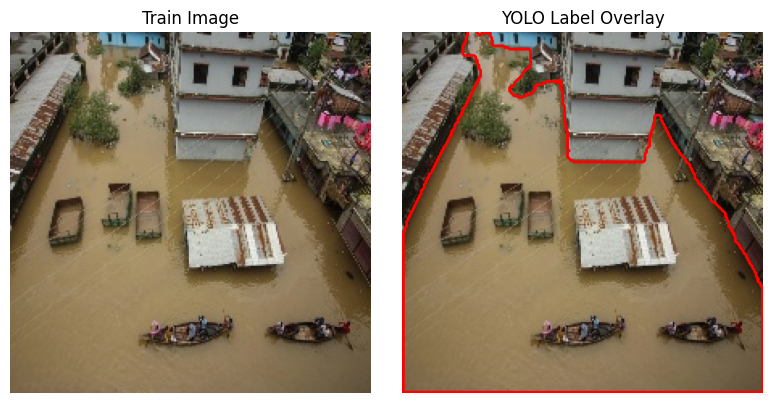

In [16]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from pathlib import Path
import random

split = "train"

base_path = Path.home() / "christina" / "dataset" / "yolo"

splits_dir = base_path / "augmented"  
aug_mask_dir = base_path / "augmented" / "masks"

img_dir   = splits_dir / split / "images"
label_dir = splits_dir / split / "labels"

# select random sample
imgs = sorted([p for p in img_dir.glob("*.jpg") if p.exists()])
idx = random.randrange(len(imgs))
img_path = imgs[idx]
label_path = label_dir / (img_path.stem + ".txt")
mask_path  = aug_mask_dir / f"{img_path.stem}.png"

#load
img = np.array(Image.open(img_path))
mask = np.array(Image.open(mask_path)) if mask_path.exists() else None

# Label-coordinates parsing
polys = []
with open(label_path) as f:
    for line in f:
        parts = line.strip().split()
        coords = list(map(float, parts[1:]))
        poly = [(coords[i] * img.shape[1], coords[i+1] * img.shape[0]) for i in range(0, len(coords), 2)]
        polys.append(poly)

# Plot
if mask is not None:
    fig, axs = plt.subplots(1, 3, figsize=(12, 4))
    axs[0].imshow(img)
    axs[0].set_title(f"{split.capitalize()} Image")
    axs[0].axis("off")

    axs[1].imshow(mask, cmap="gray")
    axs[1].set_title("Binary Mask")
    axs[1].axis("off")

    axs[2].imshow(img)
    for poly in polys:
        xs, ys = zip(*poly)
        axs[2].plot(xs, ys, '-r', linewidth=2)
    axs[2].set_title("YOLO Label Overlay")
    axs[2].axis("off")
else:
    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    axs[0].imshow(img)
    axs[0].set_title(f"{split.capitalize()} Image")
    axs[0].axis("off")

    axs[1].imshow(img)
    for poly in polys:
        xs, ys = zip(*poly)
        axs[1].plot(xs, ys, '-r', linewidth=2)
    axs[1].set_title("YOLO Label Overlay")
    axs[1].axis("off")

plt.tight_layout()
plt.show()

#### und jetzt noch die noFlood Images ergänzen:

zuerst mal für noFlood Images Data Augmentation machen:

*muss nur 1 mal gemacht werden*

In [17]:
# delete image ...otherwise [Errno 28] No space left on device

#!rm -rf ~/christina/dataset/yolo/augmented/images/*
#!rm -rf ~/christina/dataset/yolo/augmented/masks/*
#!rm -rf ~/christina/dataset/yolo/augmented/labels/*

#%run ./utils/data_noFlood_augmentation_yolo.ipynb

#print("Dataset size before augmentation: ", len(no_flood_images))
#print("Dataset size after augmentation:", len(aug_noflood_images))

```
Wrote 90 label files to no_flood_images/Image/labels

--- content of a random label file img_0030.txt ---

Dataset size before augmentation:  9
Dataset size after augmentation: 90
```

Train - Validation - Train split:

*muss nur 1 mal gemacht werden*

In [18]:
from pathlib import Path

base_path = Path.home() / "christina" / "dataset" / "yolo" / "augmented"

#split_dataset(
#    image_dir=no_flood_image_dir,
#    label_dir=no_flood_label_out_dir,
#    dest_dir=base_path,
#    train_ratio=0.7,
#    val_ratio=0.15,
#    test_ratio=0.15,
#    seed=123
#)

```
Warning: No label for no_2.jpg
Warning: No label for no_5.jpg
Warning: No label for no_14.jpg
Warning: No label for no_6.jpg
Warning: No label for no_3.jpg
Warning: No label for no_8.jpg
Warning: No label for no_12.jpg
Warning: No label for no_7.jpg
Warning: No label for no_9.jpg
```

Veränderung Anzahl der Daten:

In [19]:
from pathlib import Path

base_path = Path.home() / "christina" / "dataset" / "yolo" / "augmented"

train_images = list((base_path / "train" / "images").glob("*.jpg")) + list((base_path / "train" / "images").glob("*.png"))
val_images   = list((base_path / "val" / "images").glob("*.jpg")) + list((base_path / "val" / "images").glob("*.png"))
test_images  = list((base_path / "test" / "images").glob("*.jpg")) + list((base_path / "test" / "images").glob("*.png"))

print(f"Train: {len(train_images)} images")
print(f"Val:   {len(val_images)} images")
print(f"Test:  {len(test_images)} images")

Train: 2085 images
Val:   445 images
Test:  450 images


## Model YOLOv8




Diesmal mit freezing von Layers, weil
- die fürs transfer learning verwendete Datenmenge begrenzt ist ,
- nur die letzten Layer anpassen möchte (klassisch bei Transfer Learning).

Beim Freezing werden bestimmte Teile des Netzes nicht weiter trainiert, sondern behalten ihre pretrained Gewichte.

In YOLOv8 kann man zB den Backbone einfrieren und nur den Head weitertrainieren.

Das friert die ersten 10 Layer des Modells ein also die Early-Feature-Extraktoren (Backbone). 

In [20]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolo11n-seg.pt")  # load a pretrained model (recommended for training)

project = "YOLO - FreezeBackbone"
experiment = "YOLO - Model-FreezeBackbone"
batch_size = 16

config_file = "data_aug_yolo.yaml"

# Train the model
# with early stopping patience
results = model.train(
    data=config_file,
    epochs=100,
    project=project,
    name=experiment,
    batch=batch_size,
    device=0,
    imgsz=640,
    patience=30,
    verbose=True,
    val=True,
    freeze=10  # freeze layers
)

Ultralytics 8.3.158 🚀 Python-3.11.0rc1 torch-2.7.1+cu126 CUDA:0 (NVIDIA A100 80GB PCIe, 81156MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data_aug_yolo.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=10, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n-seg.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=YOLO - Model-FreezeBackbone, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=30, perspective=0.0, plots=T

train: Scanning /mnt/nvme/home/aie3/christina/dataset/yolo/augmented/train/labels.cache... 2085 images, 64 backgrounds, 0 corrupt: 100%|██████████| 2085/2085 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1614.8±1136.9 MB/s, size: 37.6 KB)


val: Scanning /mnt/nvme/home/aie3/christina/dataset/yolo/augmented/val/labels.cache... 445 images, 12 backgrounds, 0 corrupt: 100%|██████████| 445/445 [00:00<?, ?it/s]


Plotting labels to YOLO - FreezeBackbone/YOLO - Model-FreezeBackbone/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to YOLO - FreezeBackbone/YOLO - Model-FreezeBackbone
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/100      3.82G      1.387      3.013      2.069      1.402         79        640: 100%|██████████| 131/131 [00:17<00:00,  7.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  3.68it/s]

                   all        445       2088      0.518      0.454      0.423       0.23      0.497      0.431      0.385      0.162



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/100      4.99G      1.352      2.504      1.533      1.331         78        640: 100%|██████████| 131/131 [00:15<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.20it/s]


                   all        445       2088      0.485       0.46      0.429      0.217      0.431      0.467      0.391      0.162

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/100         5G      1.329      2.474      1.422      1.329         53        640: 100%|██████████| 131/131 [00:14<00:00,  9.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.50it/s]


                   all        445       2088      0.603      0.506      0.523      0.301      0.608      0.488      0.502      0.234

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/100         5G      1.317      2.418       1.35      1.318         58        640: 100%|██████████| 131/131 [00:13<00:00,  9.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.36it/s]


                   all        445       2088      0.624      0.528       0.56      0.334      0.597      0.521      0.535      0.251

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/100      5.01G      1.266      2.337      1.247      1.282         29        640: 100%|██████████| 131/131 [00:14<00:00,  9.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.57it/s]


                   all        445       2088      0.671      0.544      0.592      0.367      0.666      0.526      0.572      0.284

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/100      5.02G      1.232      2.306        1.2      1.252         47        640: 100%|██████████| 131/131 [00:13<00:00,  9.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.41it/s]


                   all        445       2088      0.656      0.551        0.6      0.368      0.645      0.536      0.576      0.286

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/100      5.02G      1.189      2.241      1.153      1.241         38        640: 100%|██████████| 131/131 [00:14<00:00,  8.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.37it/s]


                   all        445       2088      0.653       0.61      0.642      0.413      0.665      0.597      0.627      0.317

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/100      5.03G       1.16      2.176      1.105      1.212         66        640: 100%|██████████| 131/131 [00:14<00:00,  9.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.52it/s]


                   all        445       2088      0.666      0.622      0.653      0.418      0.649      0.602       0.62      0.297

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/100      5.03G      1.153      2.181      1.077      1.208         47        640: 100%|██████████| 131/131 [00:14<00:00,  9.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.52it/s]


                   all        445       2088      0.702      0.629      0.674      0.446      0.694      0.625      0.662      0.345

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/100      5.03G      1.121      2.123      1.035      1.195         56        640: 100%|██████████| 131/131 [00:13<00:00,  9.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.71it/s]


                   all        445       2088      0.726      0.565      0.659      0.452      0.713       0.56      0.637      0.342

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/100      5.03G      1.115      2.112      1.022      1.192         44        640: 100%|██████████| 131/131 [00:13<00:00,  9.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.63it/s]


                   all        445       2088      0.707      0.608      0.676      0.448      0.716      0.603       0.66      0.348

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/100      5.03G       1.08      2.042     0.9743      1.165         52        640: 100%|██████████| 131/131 [00:13<00:00,  9.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.60it/s]


                   all        445       2088      0.747      0.635      0.715      0.491      0.745      0.632      0.701      0.385

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/100      5.03G      1.074      2.065     0.9777      1.156         48        640: 100%|██████████| 131/131 [00:14<00:00,  9.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]


                   all        445       2088      0.777      0.644      0.723      0.493      0.779      0.644      0.714      0.381

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/100      5.03G      1.054      2.012     0.9334      1.146         67        640: 100%|██████████| 131/131 [00:13<00:00,  9.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.63it/s]


                   all        445       2088      0.801      0.667      0.754      0.529      0.806      0.647      0.738      0.406

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     15/100      5.03G      1.045      2.019     0.9234      1.147         36        640: 100%|██████████| 131/131 [00:13<00:00,  9.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.57it/s]


                   all        445       2088       0.78      0.671      0.754      0.536       0.78      0.665      0.739      0.398

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     16/100      5.03G      1.034      1.996     0.9093      1.143         36        640: 100%|██████████| 131/131 [00:13<00:00,  9.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.53it/s]


                   all        445       2088      0.798      0.683      0.768      0.549      0.805      0.677       0.76      0.415

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     17/100      5.03G      1.025      1.969     0.8939      1.137         66        640: 100%|██████████| 131/131 [00:14<00:00,  9.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.34it/s]


                   all        445       2088        0.8       0.66      0.749      0.531      0.802      0.651      0.731      0.396

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     18/100      5.03G      1.008      1.959     0.8671      1.122         36        640: 100%|██████████| 131/131 [00:14<00:00,  9.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.60it/s]


                   all        445       2088      0.816      0.683      0.776      0.557      0.805      0.684      0.764      0.421

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     19/100      5.03G      1.002      1.948      0.868      1.121         41        640: 100%|██████████| 131/131 [00:14<00:00,  9.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.55it/s]


                   all        445       2088       0.83      0.679      0.778       0.56      0.816      0.669      0.752      0.409

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/100      5.03G     0.9872      1.909     0.8478      1.109         76        640: 100%|██████████| 131/131 [00:14<00:00,  9.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.58it/s]


                   all        445       2088      0.813      0.698      0.787      0.567      0.812      0.685      0.765      0.433

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     21/100      5.04G     0.9676      1.907     0.8247      1.098         67        640: 100%|██████████| 131/131 [00:14<00:00,  9.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.52it/s]


                   all        445       2088      0.782      0.706      0.778      0.569      0.805      0.685      0.764      0.433

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     22/100      5.04G     0.9659      1.885     0.8202      1.101         50        640: 100%|██████████| 131/131 [00:13<00:00,  9.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.66it/s]


                   all        445       2088      0.834      0.698      0.797      0.584      0.827       0.69      0.779      0.437

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     23/100      5.04G     0.9529      1.898     0.8111      1.089         56        640: 100%|██████████| 131/131 [00:14<00:00,  9.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088      0.812      0.698      0.787      0.577      0.823      0.675      0.768      0.429

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     24/100      5.04G     0.9695      1.878     0.8221      1.103         37        640: 100%|██████████| 131/131 [00:13<00:00,  9.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.66it/s]


                   all        445       2088      0.845      0.699      0.798      0.593      0.843      0.683      0.776      0.437

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     25/100      5.04G     0.9512      1.851     0.8065      1.095         44        640: 100%|██████████| 131/131 [00:13<00:00,  9.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.53it/s]


                   all        445       2088      0.863      0.697      0.803        0.6      0.852      0.696      0.785      0.455

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     26/100      5.04G     0.9494      1.839     0.7902       1.09         60        640: 100%|██████████| 131/131 [00:14<00:00,  9.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.57it/s]


                   all        445       2088      0.818      0.734      0.805      0.597      0.814      0.723      0.781      0.439

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/100      5.04G     0.9312      1.842     0.7815       1.08         38        640: 100%|██████████| 131/131 [00:14<00:00,  9.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.71it/s]


                   all        445       2088       0.83      0.723      0.806      0.607      0.834       0.71      0.792      0.455

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     28/100      5.04G     0.9293      1.824     0.7893      1.084         47        640: 100%|██████████| 131/131 [00:14<00:00,  9.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]


                   all        445       2088      0.842      0.714      0.809      0.606      0.844      0.704      0.784      0.448

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     29/100      5.04G     0.9088       1.81     0.7607       1.07         49        640: 100%|██████████| 131/131 [00:13<00:00,  9.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.72it/s]


                   all        445       2088      0.841      0.731      0.817      0.613      0.834      0.724      0.797      0.464

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     30/100      5.04G     0.9176      1.808     0.7598      1.068         42        640: 100%|██████████| 131/131 [00:13<00:00,  9.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.70it/s]


                   all        445       2088      0.868      0.723      0.824      0.621      0.867      0.715      0.807      0.469

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     31/100      5.04G     0.9027      1.791     0.7577      1.072         50        640: 100%|██████████| 131/131 [00:14<00:00,  9.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.59it/s]


                   all        445       2088      0.842      0.744      0.826       0.62      0.853       0.72      0.807      0.471

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     32/100      5.04G     0.8944      1.765     0.7344      1.063         42        640: 100%|██████████| 131/131 [00:13<00:00,  9.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088      0.848      0.757      0.839      0.632       0.85      0.748      0.828      0.482

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     33/100      5.04G     0.8989       1.79     0.7357      1.061         35        640: 100%|██████████| 131/131 [00:13<00:00,  9.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.67it/s]


                   all        445       2088      0.855      0.734      0.824      0.621      0.846      0.735      0.809      0.471

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     34/100      5.04G     0.8899       1.75     0.7288      1.057         66        640: 100%|██████████| 131/131 [00:14<00:00,  8.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088      0.852      0.765      0.836      0.635      0.849      0.751      0.821      0.478

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     35/100      5.04G     0.8939      1.774     0.7293      1.058         67        640: 100%|██████████| 131/131 [00:13<00:00,  9.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.53it/s]


                   all        445       2088      0.862      0.745      0.832       0.63      0.866      0.738       0.82      0.479

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     36/100      5.04G     0.8864       1.75     0.7169      1.052         45        640: 100%|██████████| 131/131 [00:13<00:00,  9.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.67it/s]


                   all        445       2088      0.846      0.752      0.831      0.633      0.835      0.746      0.813      0.483

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     37/100      5.04G     0.8722      1.748     0.7072      1.053         46        640: 100%|██████████| 131/131 [00:14<00:00,  9.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.54it/s]


                   all        445       2088      0.856      0.754      0.837      0.636      0.851      0.746      0.825      0.484

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     38/100      5.04G     0.8785      1.727     0.7171      1.047         50        640: 100%|██████████| 131/131 [00:13<00:00,  9.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.68it/s]


                   all        445       2088      0.877      0.741      0.837      0.645      0.876      0.737      0.822       0.49

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     39/100      5.04G     0.8855      1.753     0.7117      1.056         31        640: 100%|██████████| 131/131 [00:14<00:00,  9.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]


                   all        445       2088      0.884      0.739      0.838      0.645       0.87      0.732      0.819      0.481

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     40/100      5.04G     0.8596       1.75     0.7067      1.047         58        640: 100%|██████████| 131/131 [00:13<00:00,  9.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]


                   all        445       2088      0.863      0.757      0.845       0.65      0.857      0.752      0.828      0.494

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/100      5.04G     0.8689       1.72     0.7037      1.046         47        640: 100%|██████████| 131/131 [00:14<00:00,  9.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.61it/s]


                   all        445       2088      0.876      0.757      0.842      0.654      0.872      0.752      0.829      0.496

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     42/100      5.04G     0.8543      1.689     0.6828      1.037         59        640: 100%|██████████| 131/131 [00:13<00:00,  9.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]


                   all        445       2088      0.887       0.75      0.846      0.654      0.877      0.744      0.825      0.487

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     43/100      5.04G     0.8428      1.691     0.6808      1.036         36        640: 100%|██████████| 131/131 [00:13<00:00,  9.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.57it/s]

                   all        445       2088      0.886      0.758      0.848       0.66      0.879       0.75      0.829      0.501



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     44/100      5.04G     0.8473       1.69     0.6871      1.041         27        640: 100%|██████████| 131/131 [00:14<00:00,  9.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088      0.861      0.783       0.85      0.658      0.858      0.771      0.833      0.496

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/100      5.04G     0.8497      1.685     0.6831      1.034         76        640: 100%|██████████| 131/131 [00:14<00:00,  9.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.74it/s]

                   all        445       2088      0.864      0.776      0.853      0.656      0.869      0.764      0.832      0.501



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     46/100      5.04G     0.8352       1.68      0.671      1.029         47        640: 100%|██████████| 131/131 [00:14<00:00,  9.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.66it/s]

                   all        445       2088      0.899      0.759      0.855      0.668      0.893      0.749      0.831      0.501



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     47/100      5.04G     0.8321      1.678     0.6665      1.028         42        640: 100%|██████████| 131/131 [00:14<00:00,  8.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088       0.89       0.77      0.858      0.669       0.88      0.762       0.84      0.502

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/100      5.04G     0.8451       1.69     0.6727      1.032         64        640: 100%|██████████| 131/131 [00:14<00:00,  9.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088      0.902      0.769      0.862      0.675      0.889      0.763      0.841      0.504

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     49/100      5.04G     0.8264      1.659      0.657      1.026         45        640: 100%|██████████| 131/131 [00:13<00:00,  9.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.66it/s]


                   all        445       2088      0.882      0.771      0.855      0.671      0.878      0.767      0.837      0.502

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     50/100      5.04G     0.8204      1.658      0.655      1.021         66        640: 100%|██████████| 131/131 [00:14<00:00,  9.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]

                   all        445       2088      0.881      0.769      0.857      0.671      0.895      0.751      0.842      0.515



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     51/100      5.04G     0.8253       1.65     0.6594      1.025         44        640: 100%|██████████| 131/131 [00:14<00:00,  9.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.60it/s]


                   all        445       2088      0.864      0.789      0.858      0.677      0.855      0.786      0.842      0.517

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     52/100      5.04G     0.8217      1.648     0.6528      1.022         28        640: 100%|██████████| 131/131 [00:14<00:00,  8.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088      0.889      0.769      0.857      0.671      0.881      0.763      0.839      0.512

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     53/100      5.04G     0.8069      1.631     0.6432      1.023         36        640: 100%|██████████| 131/131 [00:15<00:00,  8.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.61it/s]


                   all        445       2088      0.883      0.781       0.86      0.678      0.873      0.773      0.843      0.512

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     54/100      5.04G     0.8209      1.654     0.6446      1.024         28        640: 100%|██████████| 131/131 [00:13<00:00,  9.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.75it/s]

                   all        445       2088      0.871      0.789      0.864       0.68      0.864      0.783       0.85      0.522



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     55/100      5.04G     0.8172      1.653     0.6472      1.023         57        640: 100%|██████████| 131/131 [00:13<00:00,  9.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088        0.9      0.775      0.865      0.683      0.893      0.768      0.848       0.52

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     56/100      5.04G      0.813      1.661     0.6536      1.024         35        640: 100%|██████████| 131/131 [00:14<00:00,  9.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.72it/s]


                   all        445       2088      0.877      0.796      0.871      0.687      0.896      0.769      0.854      0.528

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     57/100      5.04G     0.7992      1.613     0.6284      1.015         41        640: 100%|██████████| 131/131 [00:14<00:00,  9.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.61it/s]

                   all        445       2088      0.879      0.792      0.869      0.685      0.881      0.778      0.852      0.528



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     58/100      5.04G     0.7842      1.592     0.6276       1.01         37        640: 100%|██████████| 131/131 [00:14<00:00,  9.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.79it/s]

                   all        445       2088      0.879      0.799      0.869      0.691      0.871      0.791      0.854      0.527



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     59/100      5.04G     0.8027       1.62     0.6336      1.013         43        640: 100%|██████████| 131/131 [00:13<00:00,  9.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.70it/s]


                   all        445       2088      0.858      0.812      0.869      0.689      0.866      0.794      0.857      0.533

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     60/100      5.04G     0.7998      1.603     0.6231      1.011         49        640: 100%|██████████| 131/131 [00:14<00:00,  9.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.77it/s]

                   all        445       2088      0.886      0.786      0.867        0.7      0.883      0.778      0.853      0.535



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     61/100      5.04G     0.7908      1.597     0.6181      1.012         47        640: 100%|██████████| 131/131 [00:15<00:00,  8.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.78it/s]

                   all        445       2088      0.875      0.806      0.874      0.698      0.877      0.797      0.862      0.533



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     62/100      5.04G     0.7828      1.595     0.6177      1.003         59        640: 100%|██████████| 131/131 [00:14<00:00,  9.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.73it/s]

                   all        445       2088      0.883      0.798      0.869      0.696      0.879      0.791      0.851       0.53



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     63/100      5.04G     0.7763      1.574     0.6185      1.008         75        640: 100%|██████████| 131/131 [00:14<00:00,  8.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.72it/s]

                   all        445       2088      0.899      0.784      0.871      0.698        0.9      0.773      0.851      0.529



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     64/100      5.04G     0.7843      1.592     0.6234      1.005         53        640: 100%|██████████| 131/131 [00:14<00:00,  9.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.77it/s]

                   all        445       2088      0.897      0.788      0.876      0.702      0.892       0.78      0.861      0.538



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     65/100      5.04G     0.7789      1.594      0.607      1.008         40        640: 100%|██████████| 131/131 [00:14<00:00,  9.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.77it/s]

                   all        445       2088      0.883      0.793      0.875      0.705      0.878      0.792       0.86       0.54



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     66/100      5.04G      0.778      1.583     0.6117      1.006        117        640: 100%|██████████| 131/131 [00:14<00:00,  9.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.72it/s]

                   all        445       2088      0.879      0.796      0.876      0.698      0.878      0.789      0.859      0.537



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     67/100      5.04G     0.7681      1.561     0.6042     0.9963         65        640: 100%|██████████| 131/131 [00:14<00:00,  9.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]

                   all        445       2088      0.879      0.801      0.876      0.702      0.876      0.795      0.857      0.533



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     68/100      5.04G     0.7642      1.569      0.608     0.9994         58        640: 100%|██████████| 131/131 [00:14<00:00,  9.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.76it/s]

                   all        445       2088      0.877      0.803      0.875      0.705      0.877      0.792      0.856      0.533



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     69/100      5.04G      0.767      1.555     0.6024     0.9983         43        640: 100%|██████████| 131/131 [00:14<00:00,  8.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.72it/s]

                   all        445       2088      0.881      0.802      0.877      0.707      0.872      0.794      0.858      0.541



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     70/100      5.04G     0.7728      1.587     0.6016     0.9974         48        640: 100%|██████████| 131/131 [00:13<00:00,  9.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.67it/s]


                   all        445       2088      0.892        0.8      0.879      0.709      0.883       0.79      0.859      0.541

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     71/100      5.04G     0.7611      1.546     0.5929     0.9959         48        640: 100%|██████████| 131/131 [00:14<00:00,  9.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.73it/s]

                   all        445       2088      0.885      0.792      0.875      0.708      0.882      0.784      0.858      0.543



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     72/100      5.04G     0.7595      1.548     0.5882     0.9961         41        640: 100%|██████████| 131/131 [00:14<00:00,  9.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.68it/s]

                   all        445       2088      0.893      0.807      0.879      0.712      0.892      0.789      0.861      0.541



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     73/100      5.04G     0.7486      1.541     0.5879     0.9922         44        640: 100%|██████████| 131/131 [00:14<00:00,  9.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.69it/s]

                   all        445       2088      0.909      0.784      0.877      0.709      0.895      0.778      0.858      0.537



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     74/100      5.04G     0.7614      1.568     0.5973      1.001         68        640: 100%|██████████| 131/131 [00:14<00:00,  9.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.79it/s]

                   all        445       2088      0.885      0.808      0.879      0.711      0.893      0.794      0.859      0.538



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     75/100      5.04G     0.7469      1.535     0.5764     0.9911         47        640: 100%|██████████| 131/131 [00:14<00:00,  9.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.73it/s]

                   all        445       2088      0.884      0.804      0.881      0.714      0.881      0.797      0.863      0.542



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     76/100      5.04G     0.7555      1.581     0.5887     0.9957         41        640: 100%|██████████| 131/131 [00:14<00:00,  9.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.69it/s]

                   all        445       2088      0.894      0.816      0.885      0.719      0.892        0.8      0.866      0.547



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     77/100      5.04G      0.748      1.551     0.5831     0.9885         43        640: 100%|██████████| 131/131 [00:14<00:00,  9.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.82it/s]

                   all        445       2088      0.882      0.815      0.884      0.721      0.884        0.8      0.866      0.551



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     78/100      5.04G     0.7385      1.536     0.5775     0.9848         38        640: 100%|██████████| 131/131 [00:13<00:00,  9.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.59it/s]

                   all        445       2088      0.881      0.819      0.885      0.723      0.875      0.807      0.866      0.546



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     79/100      5.04G     0.7328      1.522     0.5678     0.9838         65        640: 100%|██████████| 131/131 [00:14<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.75it/s]

                   all        445       2088      0.904      0.804      0.884      0.721      0.896      0.795      0.865      0.547



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     80/100      5.04G     0.7388      1.507     0.5724     0.9855         50        640: 100%|██████████| 131/131 [00:14<00:00,  8.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.75it/s]

                   all        445       2088      0.889      0.821      0.886      0.723      0.879      0.811      0.869      0.549



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     81/100      5.04G     0.7389      1.528     0.5741     0.9863         39        640: 100%|██████████| 131/131 [00:14<00:00,  9.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.76it/s]

                   all        445       2088      0.892      0.813      0.885      0.723      0.885      0.802      0.866      0.547



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     82/100      5.04G     0.7254      1.505     0.5672      0.984         58        640: 100%|██████████| 131/131 [00:13<00:00,  9.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.75it/s]

                   all        445       2088      0.876      0.832      0.888      0.724      0.868      0.822      0.871      0.554



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     83/100      5.04G     0.7312      1.511     0.5666      0.982         47        640: 100%|██████████| 131/131 [00:14<00:00,  9.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.77it/s]

                   all        445       2088      0.885      0.826      0.889      0.727      0.884      0.818      0.871      0.555



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     84/100      5.04G     0.7255      1.507     0.5575     0.9808         40        640: 100%|██████████| 131/131 [00:14<00:00,  9.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.70it/s]

                   all        445       2088      0.878      0.818      0.882      0.721      0.896      0.788      0.862      0.546



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     85/100      5.04G     0.7348      1.519     0.5714      0.984         67        640: 100%|██████████| 131/131 [00:14<00:00,  9.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.71it/s]

                   all        445       2088      0.877      0.825      0.884      0.725      0.881      0.809      0.866      0.552



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     86/100      5.04G      0.718      1.501     0.5556     0.9771         65        640: 100%|██████████| 131/131 [00:14<00:00,  9.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.80it/s]

                   all        445       2088      0.897      0.821      0.888       0.73       0.89      0.816      0.874      0.559



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     87/100      5.04G      0.722      1.498     0.5629     0.9795         58        640: 100%|██████████| 131/131 [00:13<00:00,  9.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.73it/s]

                   all        445       2088      0.892      0.817      0.887      0.728      0.901      0.795      0.867      0.556



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     88/100      5.04G     0.7206      1.504     0.5529       0.98         30        640: 100%|██████████| 131/131 [00:14<00:00,  9.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.76it/s]

                   all        445       2088      0.895      0.823      0.888      0.729      0.887      0.816      0.871      0.553



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     89/100      5.04G     0.7195      1.491     0.5547     0.9804         67        640: 100%|██████████| 131/131 [00:14<00:00,  9.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.77it/s]

                   all        445       2088      0.886      0.823      0.887       0.73      0.879      0.813      0.869      0.554



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.04G     0.7148      1.486      0.557     0.9796         63        640: 100%|██████████| 131/131 [00:14<00:00,  9.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.77it/s]

                   all        445       2088      0.893      0.822      0.889      0.733      0.887       0.81       0.87      0.557


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.04G     0.6818      1.448     0.5246     0.9716         40        640: 100%|██████████| 131/131 [00:15<00:00,  8.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.73it/s]

                   all        445       2088      0.894      0.821      0.886      0.725      0.892       0.81      0.869      0.554



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     92/100      5.04G     0.6628      1.415     0.4966     0.9551         39        640: 100%|██████████| 131/131 [00:13<00:00,  9.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.78it/s]

                   all        445       2088      0.905      0.817       0.89      0.734      0.901      0.808      0.872      0.558



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.04G     0.6614      1.411     0.4913     0.9587         32        640: 100%|██████████| 131/131 [00:14<00:00,  9.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.62it/s]

                   all        445       2088      0.888      0.831      0.892      0.736      0.893      0.813      0.876      0.559



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     94/100      5.04G     0.6474      1.403     0.4796     0.9518         13        640: 100%|██████████| 131/131 [00:14<00:00,  8.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.78it/s]

                   all        445       2088      0.887      0.828      0.895      0.738      0.886      0.823      0.879      0.564



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.04G     0.6473      1.392     0.4764     0.9476         22        640: 100%|██████████| 131/131 [00:14<00:00,  8.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.78it/s]

                   all        445       2088      0.895      0.825      0.894      0.738      0.898      0.816      0.877      0.561



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     96/100      5.04G     0.6467      1.394     0.4794     0.9505         34        640: 100%|██████████| 131/131 [00:14<00:00,  9.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.81it/s]

                   all        445       2088      0.904      0.823      0.895      0.739        0.9      0.814      0.879      0.565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     97/100      5.04G     0.6401      1.386     0.4706     0.9502         15        640: 100%|██████████| 131/131 [00:14<00:00,  8.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.75it/s]

                   all        445       2088      0.903      0.825      0.896      0.741      0.899      0.815      0.879      0.564



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     98/100      5.04G     0.6396      1.378     0.4723     0.9424         15        640: 100%|██████████| 131/131 [00:14<00:00,  8.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.68it/s]

                   all        445       2088      0.894      0.832      0.897      0.743      0.897      0.819       0.88      0.567



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     99/100      5.04G     0.6336      1.376     0.4709     0.9424         28        640: 100%|██████████| 131/131 [00:14<00:00,  8.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.79it/s]

                   all        445       2088      0.912      0.819      0.896      0.745       0.91      0.811      0.881      0.568



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    100/100      5.04G     0.6226      1.371      0.464     0.9424         26        640: 100%|██████████| 131/131 [00:14<00:00,  9.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.61it/s]


                   all        445       2088      0.901      0.826      0.896      0.743      0.907      0.816      0.881      0.569

100 epochs completed in 0.474 hours.
Optimizer stripped from YOLO - FreezeBackbone/YOLO - Model-FreezeBackbone/weights/last.pt, 6.0MB
Optimizer stripped from YOLO - FreezeBackbone/YOLO - Model-FreezeBackbone/weights/best.pt, 6.0MB

Validating YOLO - FreezeBackbone/YOLO - Model-FreezeBackbone/weights/best.pt...
Ultralytics 8.3.158 🚀 Python-3.11.0rc1 torch-2.7.1+cu126 CUDA:0 (NVIDIA A100 80GB PCIe, 81156MiB)
YOLO11n-seg summary (fused): 113 layers, 2,834,763 parameters, 0 gradients, 10.2 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/14 [00:00<?, ?it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   7%|▋         | 1/14 [00:00<00:02,  4.89it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  14%|█▍        | 2/14 [00:00<00:03,  3.82it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  4.33it/s]


                   all        445       2088      0.913      0.818      0.896      0.745      0.911      0.812      0.881      0.568
Speed: 0.1ms preprocess, 0.6ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to YOLO - FreezeBackbone/YOLO - Model-FreezeBackbone


Resluts are stored in Folder YOLO - Data Augmentation



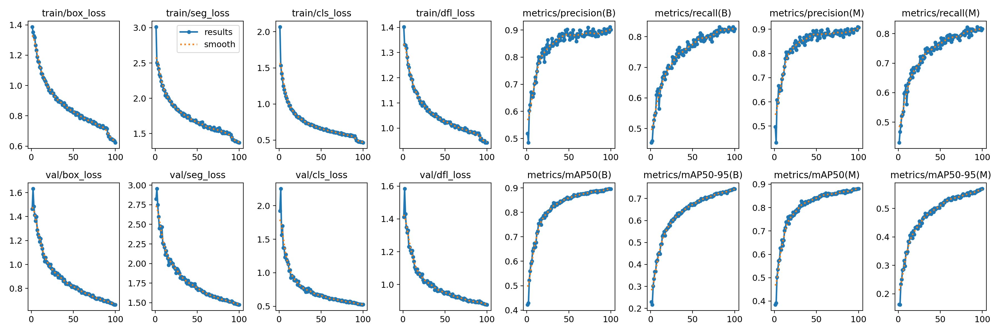

In [22]:
image_path = "YOLO - FreezeBackbone/YOLO - Model-FreezeBackbone/results.png"

from IPython.display import Image
Image(filename=image_path)

##### Confusion Matrix normalisiert:

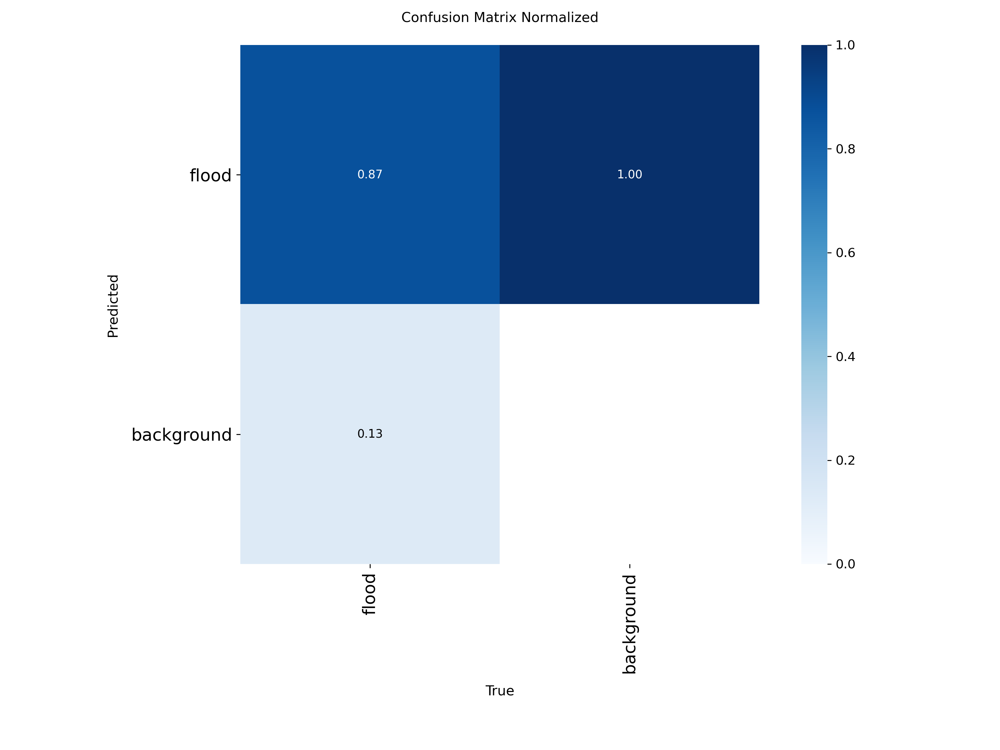

In [23]:
image_path = "YOLO - FreezeBackbone/YOLO - Model-FreezeBackbone/confusion_matrix_normalized.png"

from IPython.display import Image
Image(filename=image_path)

In [24]:
model.info()

YOLO11n-seg summary: 203 layers, 2,842,803 parameters, 0 gradients, 10.4 GFLOPs


(203, 2842803, 0, 10.355763199999998)

In [25]:
results

ultralytics.utils.metrics.SegmentMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7fc876a02a90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(M)', 'F1-Confidence(M)', 'Precision-Confidence(M)', 'Recall-Confidence(M)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041, 

### Modell-Architektur

In [26]:
from torchinfo import summary
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.model.to(device)

summary(model.model, input_size=(1, 3, 640, 640), col_names=["input_size", "output_size", "num_params", "trainable"])

Layer (type:depth-idx)                                       Input Shape               Output Shape              Param #                   Trainable
SegmentationModel                                            [1, 3, 640, 640]          [1, 37, 8400]             --                        False
├─Sequential: 1-1                                            --                        --                        --                        False
│    └─Conv: 2-1                                             [1, 3, 640, 640]          [1, 16, 320, 320]         --                        False
│    │    └─Conv2d: 3-1                                      [1, 3, 640, 640]          [1, 16, 320, 320]         (432)                     False
│    │    └─BatchNorm2d: 3-2                                 [1, 16, 320, 320]         [1, 16, 320, 320]         (32)                      False
│    └─Segment: 2-124                                        --                        --                        (recursive)  

### Train und Validation batches anzeigen

Train batches shown: 6
Val batches shown:   6


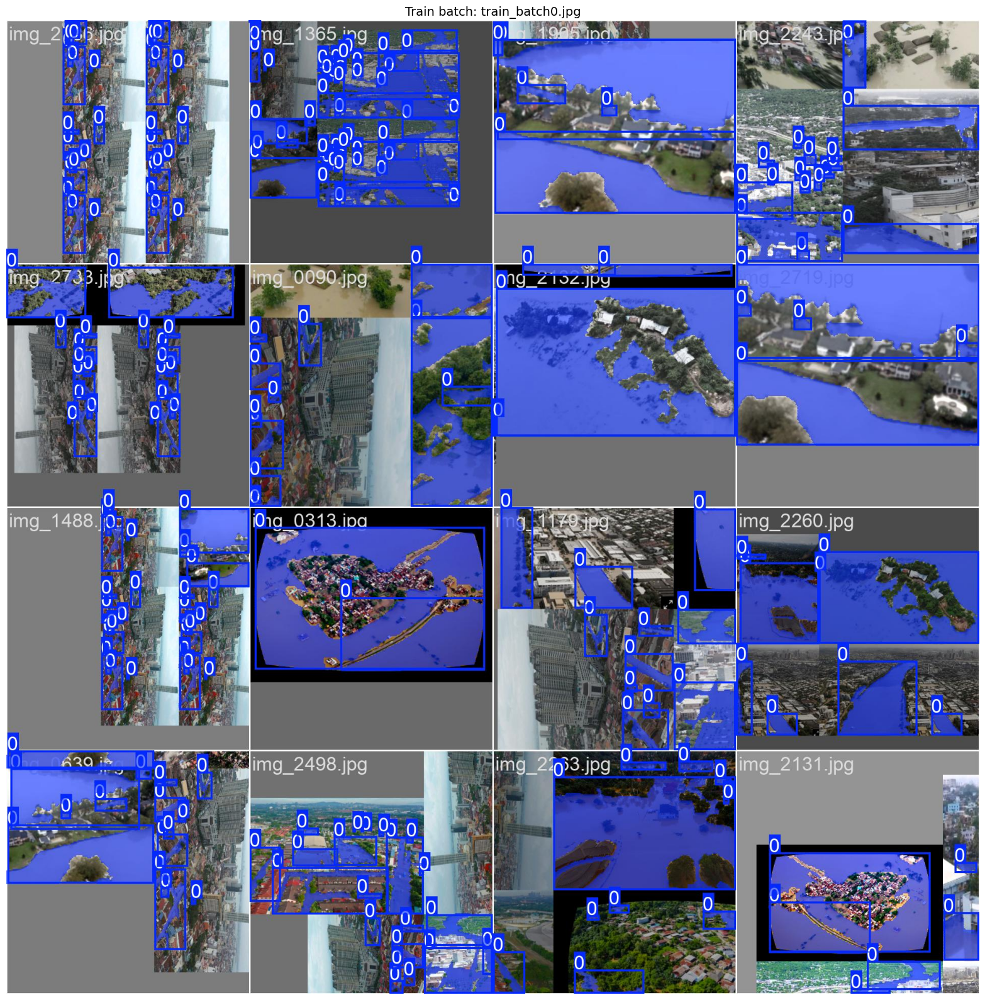

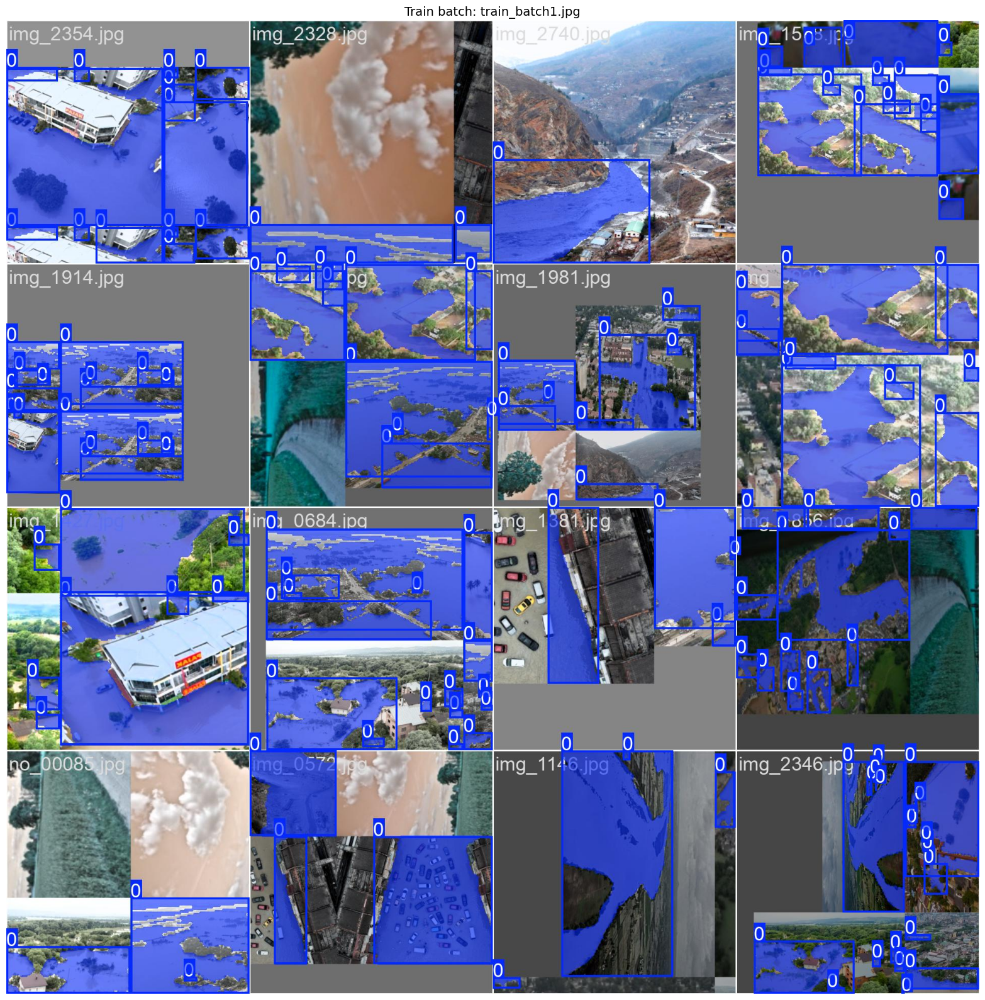

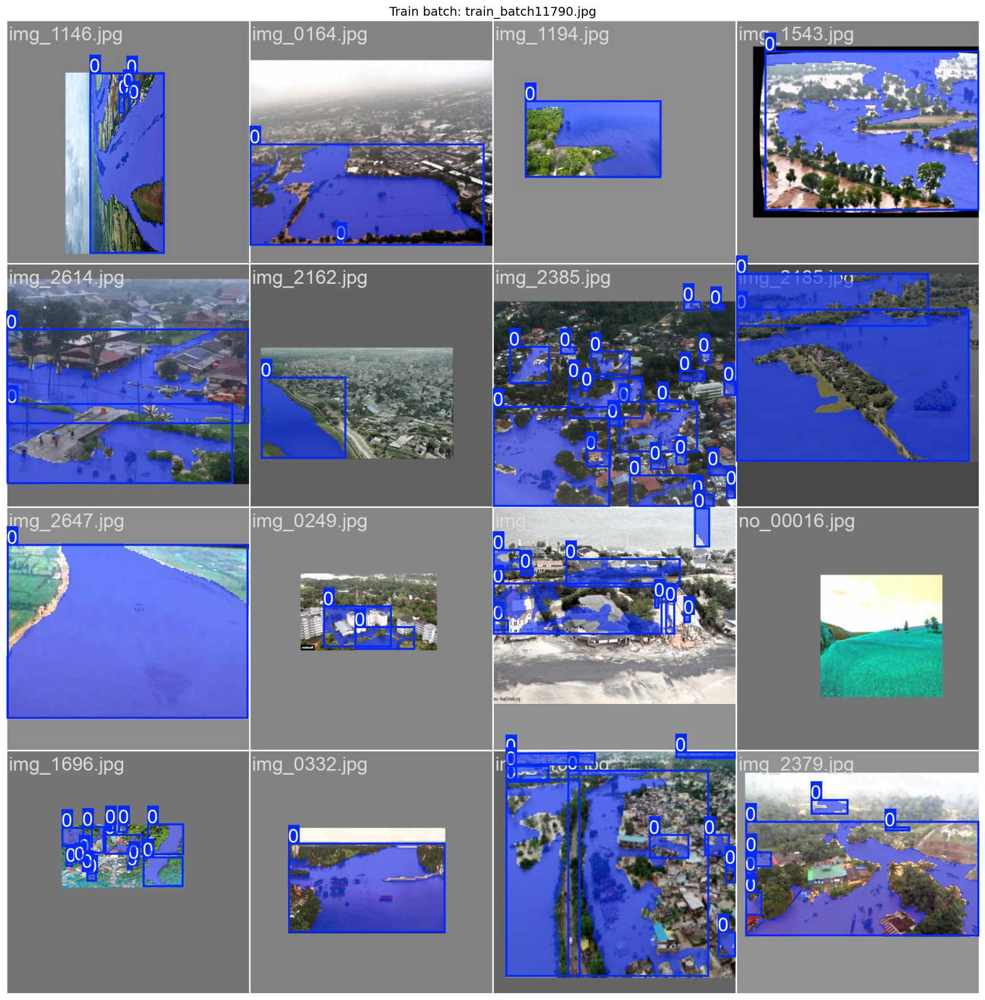

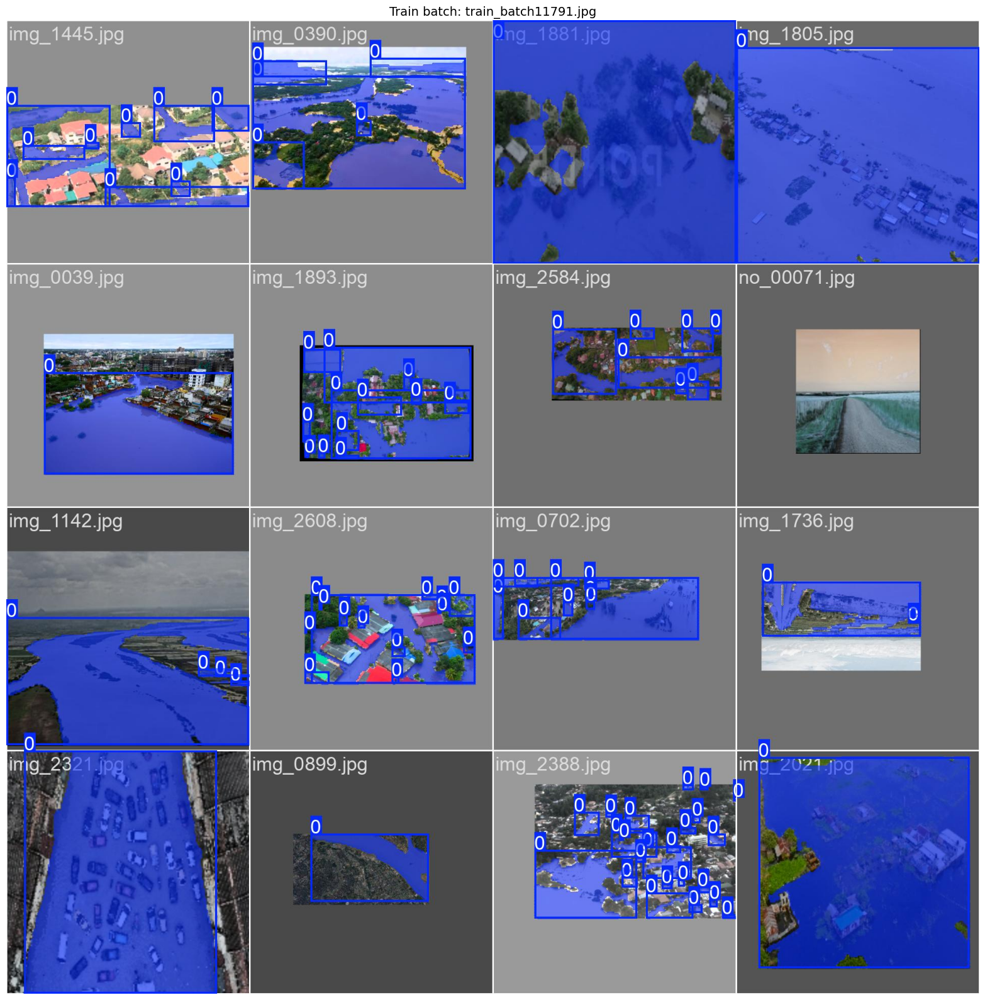

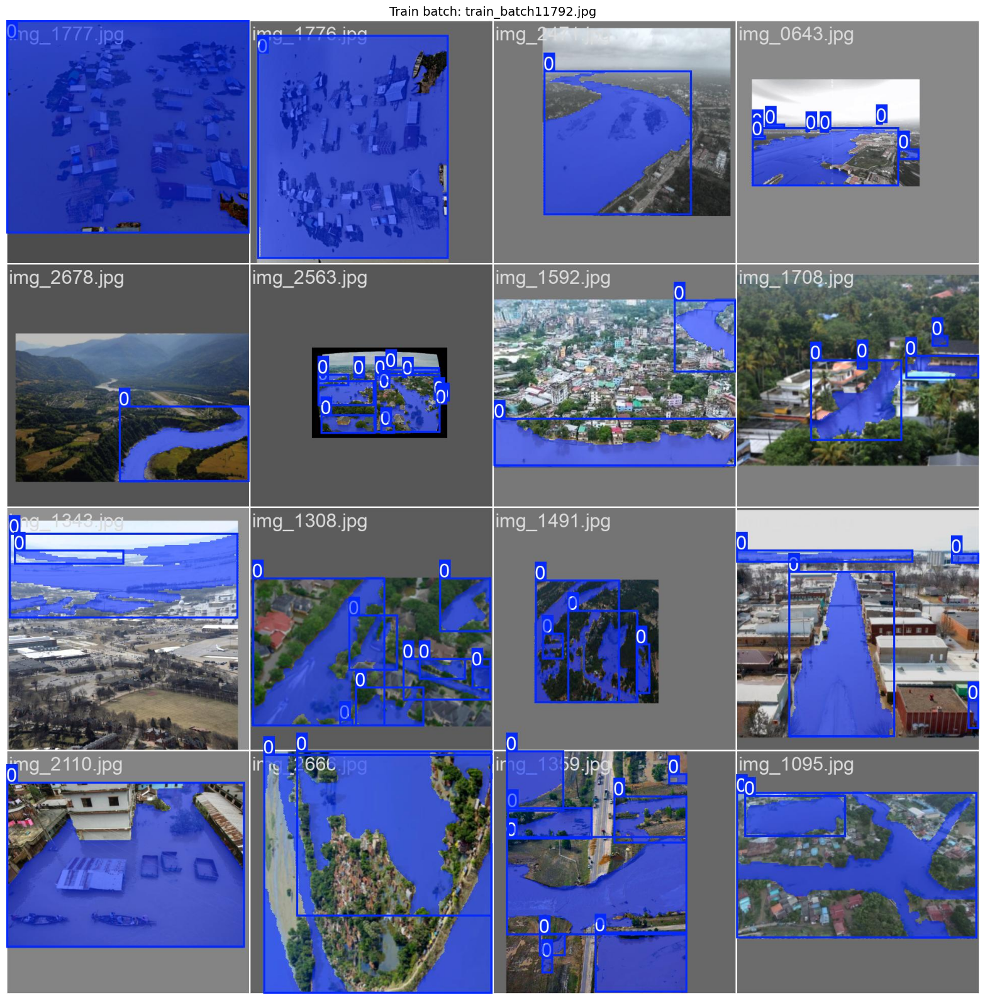

...

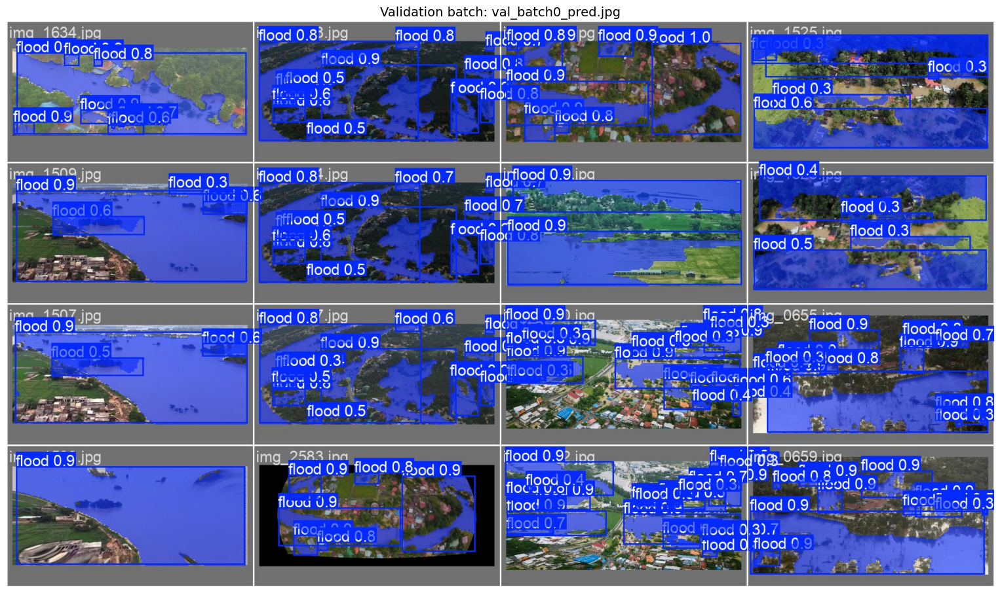

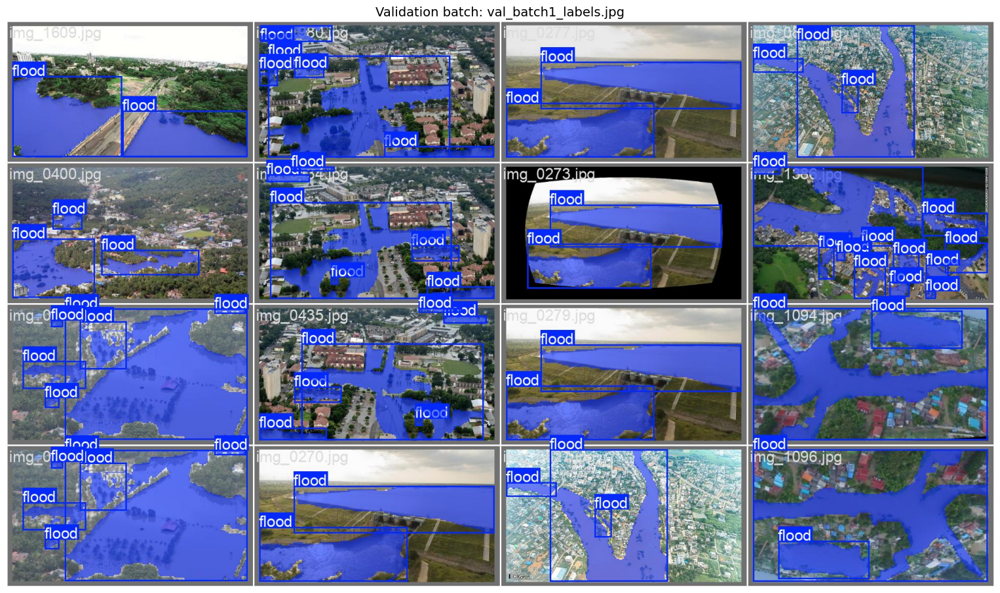

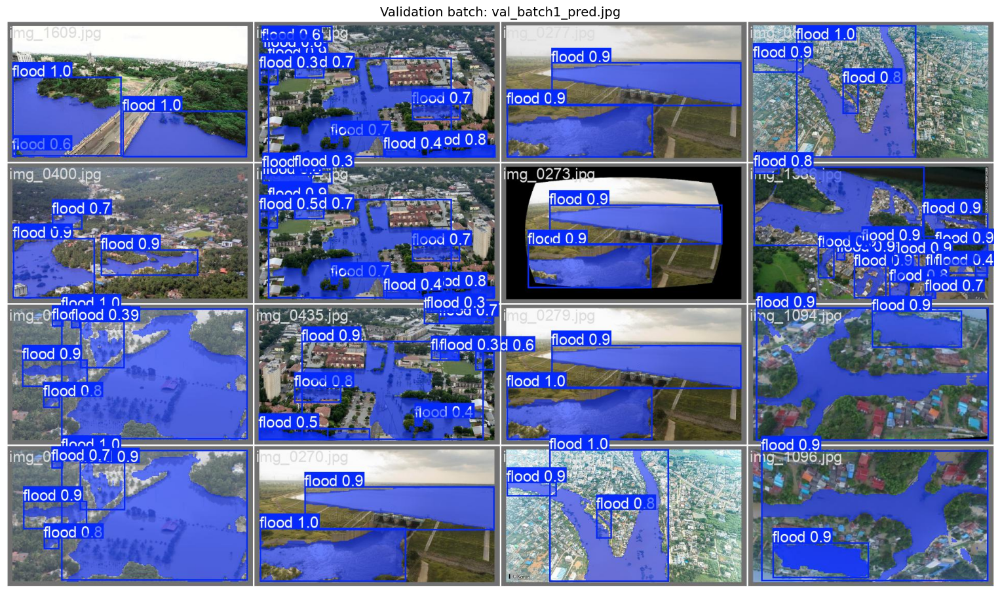

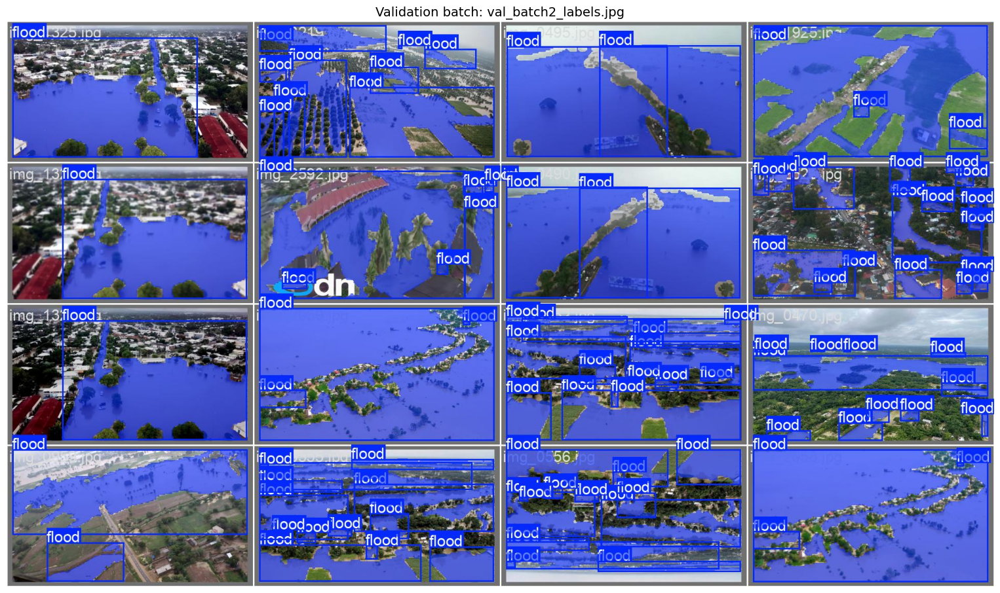

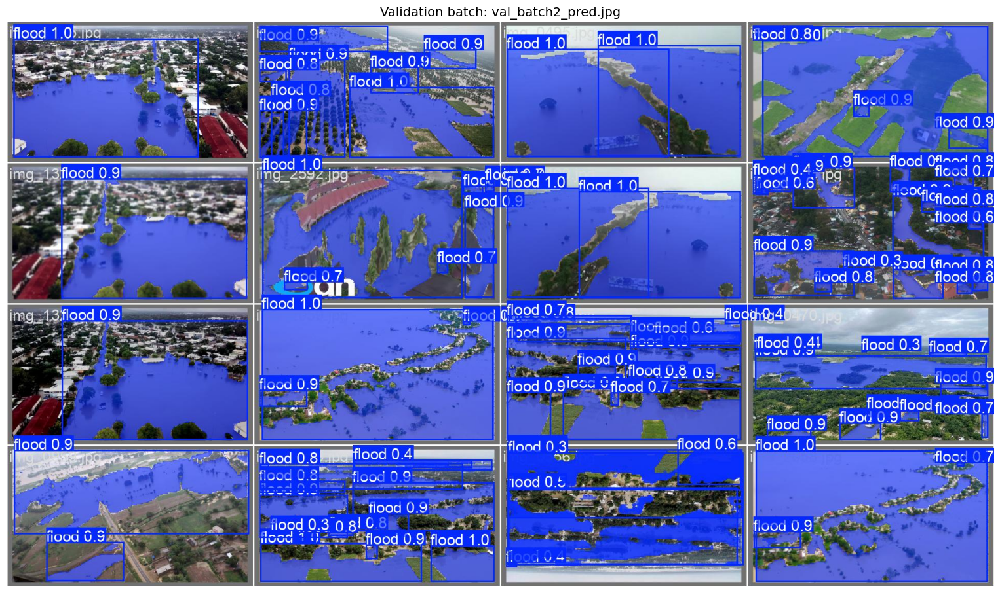

In [27]:
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image

batch_dir = Path("YOLO - FreezeBackbone/YOLO - Model-FreezeBackbone")

train_imgs = sorted(batch_dir.glob("train_batch*.jpg"))
val_imgs = sorted(batch_dir.glob("val_batch*.jpg"))

train_imgs = train_imgs[:6]
val_imgs = val_imgs[:6]

print(f"Train batches shown: {len(train_imgs)}")
print(f"Val batches shown:   {len(val_imgs)}")

def show_images(image_paths, title_prefix):
    for img_path in image_paths:
        img = Image.open(img_path)

        width, height = img.size
        aspect_ratio = height / width

        fig_width = 16
        fig_height = fig_width * aspect_ratio

        plt.figure(figsize=(fig_width, fig_height))
        plt.imshow(img)
        plt.title(f"{title_prefix}: {img_path.name}", fontsize=14)
        plt.axis('off')
        plt.tight_layout()
        plt.show()

show_images(train_imgs, "Train batch")
show_images(val_imgs, "Validation batch")

##### Mit Testdaten 


0: 640x640 (no detections), 22.9ms
Speed: 3.3ms preprocess, 22.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


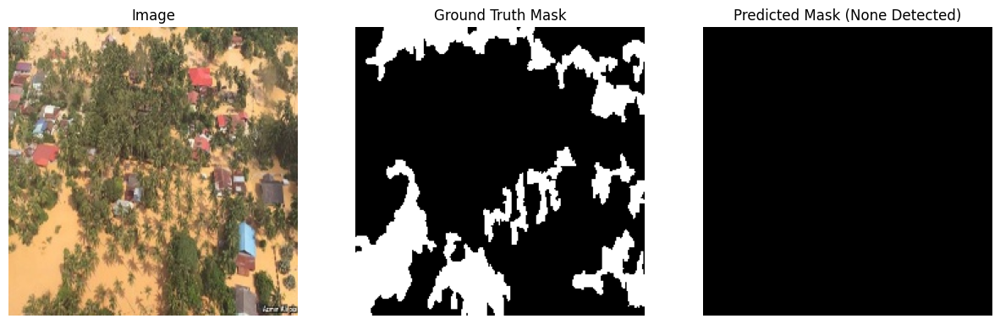


0: 448x640 1 flood, 9.7ms
Speed: 2.1ms preprocess, 9.7ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


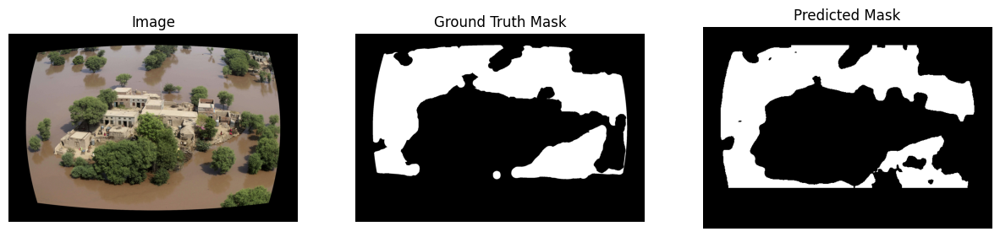


0: 480x640 1 flood, 9.6ms
Speed: 1.9ms preprocess, 9.6ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


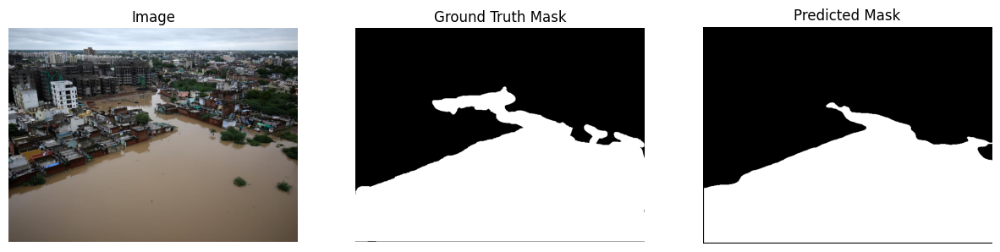


0: 384x640 3 floods, 9.7ms
Speed: 1.6ms preprocess, 9.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


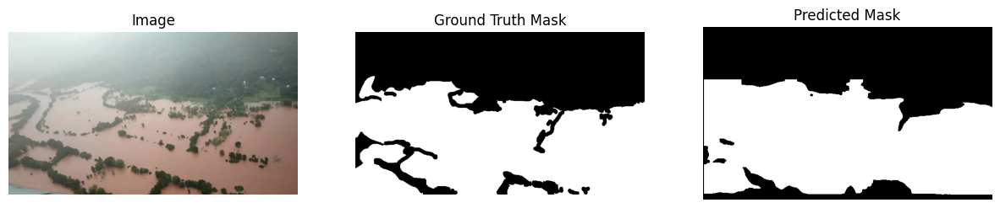


0: 384x640 2 floods, 9.4ms
Speed: 1.8ms preprocess, 9.4ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


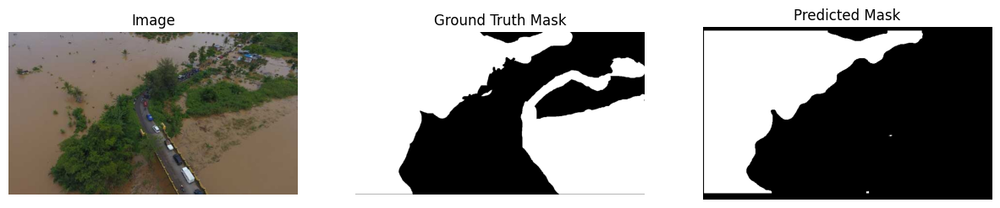

In [32]:
from pathlib import Path
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

base_path = Path.home() / "christina" / "dataset" / "yolo" / "augmented"
test_img_dir = base_path / "test" / "images"
test_label_dir = base_path / "test" / "labels"

test_images = sorted(test_img_dir.glob("*.png")) + sorted(test_img_dir.glob("*.jpg"))

# loading the ground truth mask from label file (YOLO polygon format)
def load_gt_mask(label_path, img_size):
    mask = np.zeros(img_size, dtype=np.uint8)
    if not label_path.exists():
        return mask
    with open(label_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            coords = list(map(float, parts[1:]))
            # Coordinates normalized, convert to pixels
            poly = [(int(x * img_size[1]), int(y * img_size[0])) for x, y in zip(coords[0::2], coords[1::2])]
            # Fill polygon (OpenCV required)
            import cv2
            pts = np.array(poly, dtype=np.int32)
            cv2.fillPoly(mask, [pts], 255)
    return mask

def visualize_test_predictions(model, test_images, test_label_dir, num_images=5):
    for img_path in test_images[:num_images]:
        try:
            img = np.array(Image.open(img_path).convert("RGB"))
        except Exception as e:
            print(f"Skipping {img_path.name}: {e}")
            continue
        label_path = test_label_dir / (img_path.stem + ".txt")
        gt_mask = load_gt_mask(label_path, img.shape[:2])

        # predict with YOLO
        result = model.predict(img)[0]

        plt.figure(figsize=(15,5))

        plt.subplot(1,3,1)
        plt.title("Image")
        plt.imshow(img)
        plt.axis("off")

        plt.subplot(1,3,2)
        plt.title("Ground Truth Mask")
        plt.imshow(gt_mask, cmap="gray")
        plt.axis("off")

        plt.subplot(1,3,3)
        plt.title("Predicted Mask")
        if result.masks is not None and result.masks.data.shape[0] > 0:
            pred_mask = result.masks.data.cpu().numpy()[0]
            plt.imshow(pred_mask, cmap="gray")
        else:
            plt.imshow(np.zeros_like(gt_mask), cmap="gray")
            plt.title("Predicted Mask (None Detected)")
        plt.axis("off")

        plt.show()


visualize_test_predictions(model, test_images, test_label_dir, num_images=5)

#### Evaluierung mit Testdaten

Zu beachten ist jedoch:
- Verwendung von `model.predict()` auf den Testbildern, um die vom YOLOv8-Modell vorhergesagten Segmentierungs-Masken zu erhalten.
- Da YOLO mehrere Masken pro Bild zurückgeben kann, werden diese zu einer einzigen Maske pro Bild ( per Pixel-Maximum) kombiniert.
- Die vorhergesagten Masken und Ground-Truth-Masken werden binarisiert (Threshold 0.5) und in flache Arrays umgeformt, um sie mit sklearn-Metriken auswerten zu können.
- Precision, Recall, F1-Score und Intersection-over-Union (IoU) werden für jede Maske einzeln berechnet und danach der Mittelwert über alle Testbilder ermittlet.


Testdaten vorbereiten

In [33]:
from pathlib import Path
from PIL import Image
import numpy as np
import cv2

desired_size = (640, 640)

base_path = Path.home() / "christina" / "dataset" / "yolo" / "augmented"
test_images_dir = base_path / "test" / "images"
test_labels_dir = base_path / "test" / "labels"

test_image_paths = sorted(list(test_images_dir.glob("*.jpg")))

X_test = [np.array(Image.open(p)) for p in test_image_paths]

def label_to_mask(label_path, img_shape, desired_size=(640, 640)):
    import cv2
    mask = np.zeros(img_shape[:2], dtype=np.uint8)
    with open(label_path) as f:
        for line in f:
            parts = line.strip().split()
            coords = list(map(float, parts[1:]))
            pts = np.array([[int(x * img_shape[1]), int(y * img_shape[0])] for x, y in zip(coords[::2], coords[1::2])])
            cv2.fillPoly(mask, [pts], 255)
    mask_resized = cv2.resize(mask, desired_size, interpolation=cv2.INTER_NEAREST)
    return mask_resized

y_test = []
for img_path in test_image_paths:
    label_path = test_labels_dir / f"{img_path.stem}.txt"
    img_shape = np.array(Image.open(img_path)).shape
    mask = label_to_mask(label_path, img_shape, desired_size=desired_size) if label_path.exists() else np.zeros(desired_size, dtype=np.uint8)
    y_test.append(mask)

y_test = np.array(y_test)

In [34]:
import numpy as np
from sklearn.metrics import precision_score, recall_score, f1_score, jaccard_score
from PIL import Image


def extract_masks(results, image_shape=(640, 640)):
    masks = []
    for r in results:
        if r.masks is None:
            masks.append(np.zeros(image_shape, dtype=np.uint8))
        else:
            # result.masks.data shape: [num_masks, H, W]
            mask = r.masks.data.cpu().numpy()
            #  If several masks use only the first mask. Or combine all masks into one (max per pixel)
            combined_mask = np.max(mask, axis=0) if mask.shape[0] > 1 else mask[0]
            masks.append(combined_mask)
    return np.array(masks)

# Example: X_test is list/array of images, y_test is GT masks as np.array
results = model.predict(source=[str(p) for p in test_image_paths])

y_pred_masks = extract_masks(results, image_shape=(640, 640))

# Binarization with Threshold 0.5
y_pred_binary = (y_pred_masks > 0.5).astype(int)
y_true_binary = (y_test > 0.5).astype(int)

# flatten for sklearn metrics
y_true_flat = y_true_binary.reshape(y_true_binary.shape[0], -1)
y_pred_flat = y_pred_binary.reshape(y_pred_binary.shape[0], -1)

# Calculate metrics per image and calculate average value
precisions = []
recalls = []
f1s = []
ious = []

for yt, yp in zip(y_true_flat, y_pred_flat):
    if yt.sum() == 0 and yp.sum() == 0:
        # Perfekter Fall: kein GT, kein Prediction
        precisions.append(1.0)
        recalls.append(1.0)
        f1s.append(1.0)
        ious.append(1.0)
    else:
        precisions.append(precision_score(yt, yp, zero_division=0))
        recalls.append(recall_score(yt, yp, zero_division=0))
        f1s.append(f1_score(yt, yp, zero_division=0))
        ious.append(jaccard_score(yt, yp, zero_division=0))

print("\n===== Final Test Evaluation =====")
print(f"Precision: {np.mean(precisions):.4f}")
print(f"Recall:    {np.mean(recalls):.4f}")
print(f"F1 Score:  {np.mean(f1s):.4f}")
print(f"IoU:       {np.mean(ious):.4f}")


0: 640x640 14 floods, 0.6ms
1: 640x640 2 floods, 0.6ms
2: 640x640 1 flood, 0.6ms
3: 640x640 4 floods, 0.6ms
4: 640x640 2 floods, 0.6ms
5: 640x640 2 floods, 0.6ms
6: 640x640 3 floods, 0.6ms
7: 640x640 4 floods, 0.6ms
8: 640x640 3 floods, 0.6ms
9: 640x640 3 floods, 0.6ms
10: 640x640 3 floods, 0.6ms
11: 640x640 6 floods, 0.6ms
12: 640x640 2 floods, 0.6ms
13: 640x640 8 floods, 0.6ms
14: 640x640 3 floods, 0.6ms
15: 640x640 3 floods, 0.6ms
16: 640x640 1 flood, 0.6ms
17: 640x640 7 floods, 0.6ms
18: 640x640 1 flood, 0.6ms
19: 640x640 1 flood, 0.6ms
20: 640x640 2 floods, 0.6ms
21: 640x640 3 floods, 0.6ms
22: 640x640 3 floods, 0.6ms
23: 640x640 2 floods, 0.6ms
24: 640x640 2 floods, 0.6ms
25: 640x640 3 floods, 0.6ms
26: 640x640 5 floods, 0.6ms
27: 640x640 10 floods, 0.6ms
28: 640x640 8 floods, 0.6ms
29: 640x640 8 floods, 0.6ms
30: 640x640 2 floods, 0.6ms
31: 640x640 5 floods, 0.6ms
32: 640x640 5 floods, 0.6ms
33: 640x640 2 floods, 0.6ms
34: 640x640 1 flood, 0.6ms
35: 640x640 1 flood, 0.6ms
36: 6

## Model speichern

In [35]:
# saves the trained model to the file
model.save('./trained_models/yolo_freezeBackbone_model.pt')

### Vorhersagen mit Überschwemmungsbildern aus Österreich
Test ob das gespeicherte Model ist nutzbar

In [40]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_prediction_yolo(image_resized, pred_binary, img_file=None, alpha=0.5):
    image_resized = image_resized.astype(np.uint8)
    red_mask = np.zeros_like(image_resized)
    red_mask[..., 0] = 255  # red

    # creates 3-channel mask from pred_binary
    mask_3ch = np.stack([pred_binary]*3, axis=-1)

    blended = np.where(mask_3ch, 
                       (1 - alpha) * image_resized + alpha * red_mask,
                       image_resized).astype(np.uint8)

    plt.figure(figsize=(12,4))
    if img_file:
        plt.suptitle(f"Prediction: {img_file}")
    plt.subplot(1,3,1)
    plt.title("Original Image")
    plt.imshow(image_resized)
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.title("Predicted Mask")
    plt.imshow(pred_binary, cmap='gray')
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.title("Overlay")
    plt.imshow(blended)
    plt.axis('off')

    plt.tight_layout()
    plt.show()

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image1.jpg: 448x640 3 floods, 8.7ms
Speed: 1.8ms preprocess, 8.7ms inference, 2.2ms postprocess per image at shape (1, 3, 448, 640)


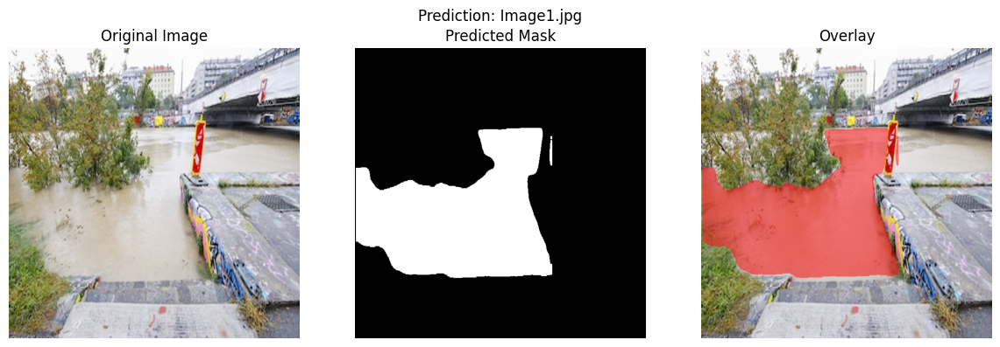

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image2.jpg: 544x640 3 floods, 59.0ms
Speed: 2.2ms preprocess, 59.0ms inference, 2.1ms postprocess per image at shape (1, 3, 544, 640)


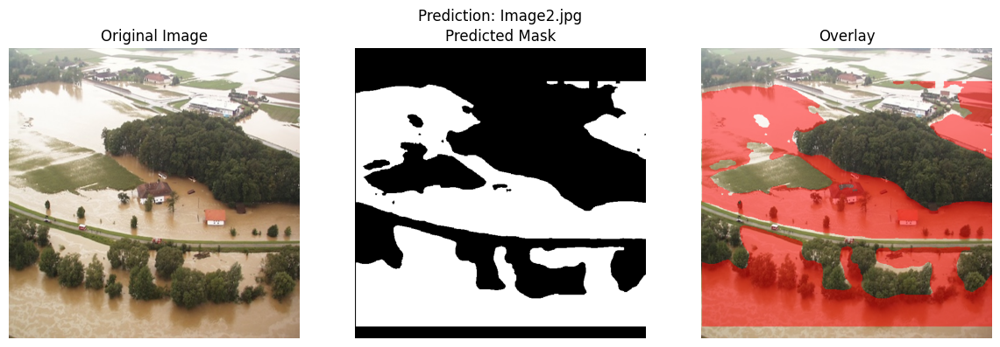

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image3.jpg: 448x640 3 floods, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


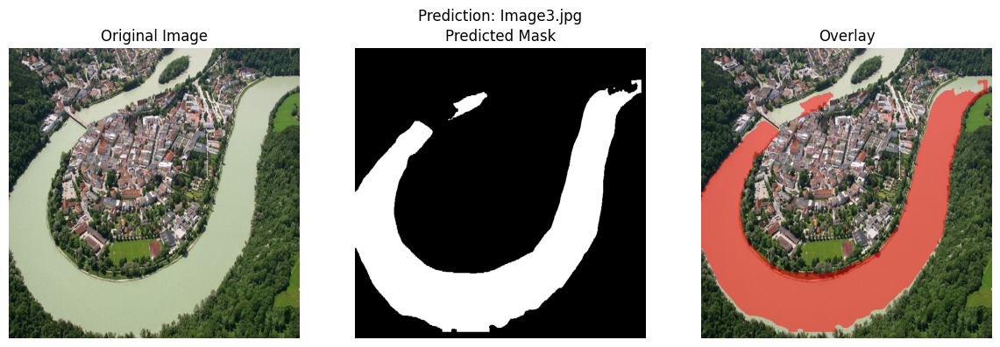

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image4.jpg: 384x640 1 flood, 10.1ms
Speed: 1.7ms preprocess, 10.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


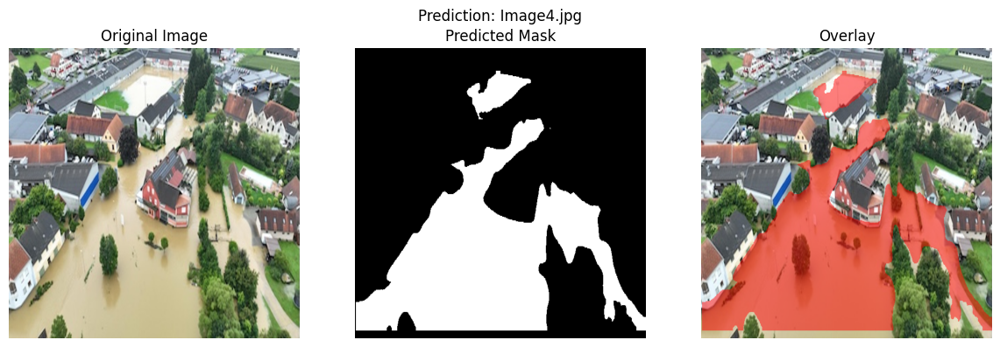

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image5.jpg: 640x544 1 flood, 58.5ms
Speed: 2.1ms preprocess, 58.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 544)


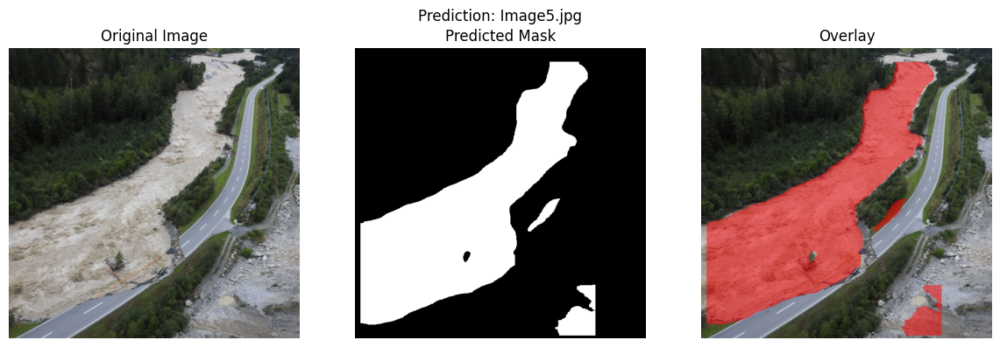

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image6.jpg: 384x640 1 flood, 9.7ms
Speed: 1.7ms preprocess, 9.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


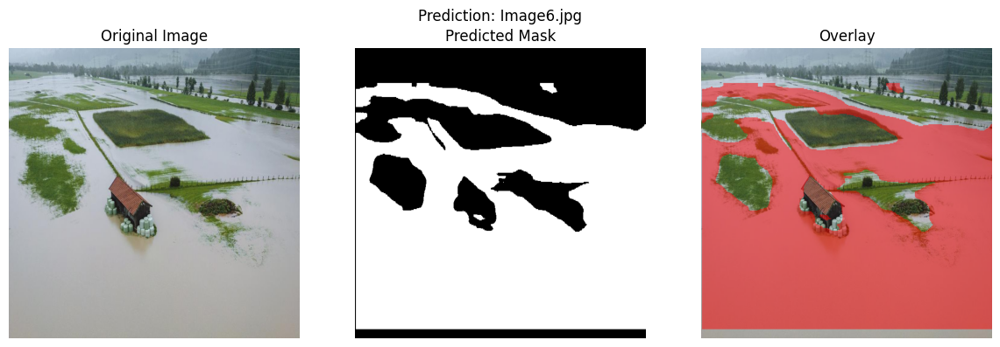

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image7.jpg: 480x640 1 flood, 10.0ms
Speed: 1.4ms preprocess, 10.0ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


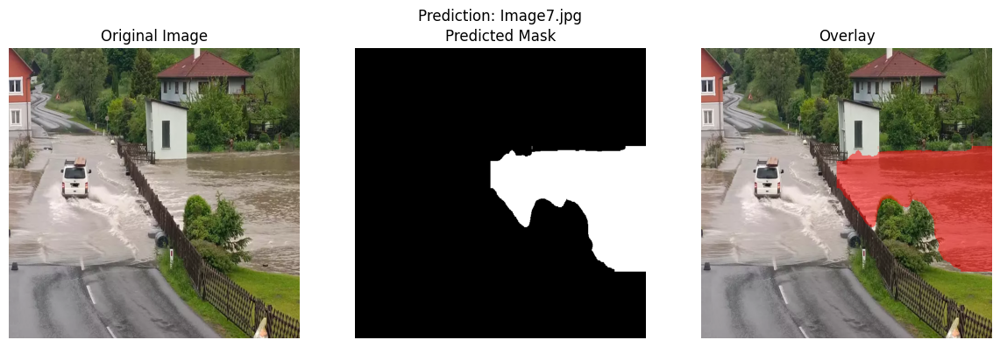

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image8.jpg: 480x640 1 flood, 9.2ms
Speed: 2.2ms preprocess, 9.2ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


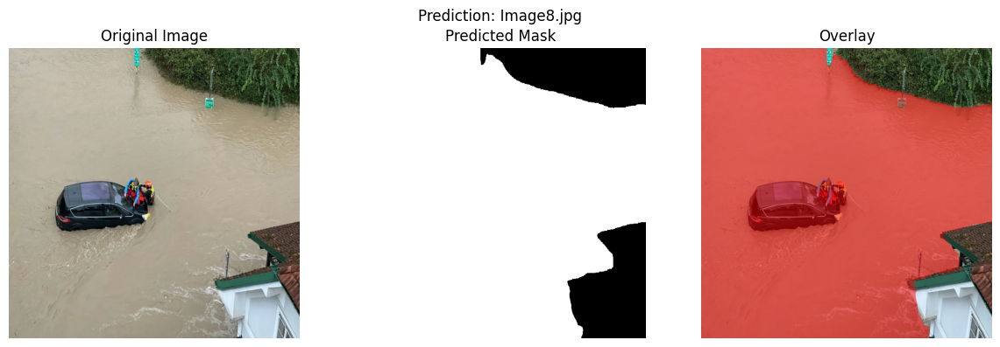

In [41]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from ultralytics import YOLO
#from utils.visualize_prediction_yolo import visualize_prediction_yolo
import cv2

IMG_HEIGHT, IMG_WIDTH = 640, 640
IMAGE_FOLDER = 'flood_images'  
ALPHA = 0.5  # Transparency of the mask

# load the model
model = YOLO('./trained_models/yolo_freezeBackbone_model.pt')

# use images for predictions
image_files = sorted(os.listdir(IMAGE_FOLDER))
image_files = sorted(os.listdir(IMAGE_FOLDER))
for img_file in image_files:
    img_path = os.path.join(IMAGE_FOLDER, img_file)

    # Load image and scale to YOLO input size (YOLO also scales automatically internally)
    image = Image.open(img_path).convert("RGB") 
    image_resized = image.resize((IMG_WIDTH, IMG_HEIGHT))
    image_array = np.array(image_resized)
    print(image_array.shape)

    # YOLOv8 expects either path, array or tensor as input, here array as batch
    results = model.predict(source=img_path)

    pred_mask = results[0].masks.data.cpu().numpy()[0]
    pred_mask_resized = cv2.resize(pred_mask, (image_array.shape[1], image_array.shape[0]), interpolation=cv2.INTER_LINEAR)

    pred_binary = (pred_mask_resized > 0.5).astype(np.uint8)

    visualize_prediction_yolo(
        image_resized=image_array,
        pred_binary=pred_binary,
        img_file=img_file,
        alpha=ALPHA
    )


# TODO Yolo and U-NET

- [ ] in einem extra Dokument Ergebniss (Diagramme) vergleichen 
- [ ] Ergebnisse vergleichen und interpretieren (Text also Literatur) und verstehen - warum verwenden wir sie und was sagen sie aus? -> Diagramme 
- [ ] interesting finding dokumentieren (positv und negativ)
- [ ] pretrained Modell verstehen (YOLO-Analyse) ... zB KLasse (aus was besteht es und wie verwenden wir es) 
- [ ] Modellarchitekturen pro Modellversion und Methode (U-NET - YOLO)
- [ ] für Vergleich: Tabelle mit Hyperparametern und man sieht auf einen Blick die Ergebniss - Diagramme mehrere in einen Bild (auf schlüssige/eindeutige Beschriftung achten) - alles schön klar 
- [ ] Doku nur in jupyter NB ist ok - weiß nicht ob wir das machen wollen
- [ ] slides schon machen - wesentliche ERgebnisse 
- [ ] Tabelle machen (mit verschiedenen Hyperparametern und ERgebnissen Metriken ) - Diagramme (schlüssig bezeichnen nach Modellversion und )
- [ ] tensor - hyperparmater während modelltraining anpassen 

Verbesserungen am YOLO
- [ ] fine-tuning von yolo - freezing (sinnvoll) - mehr daten (data augmentation verwenden) usw.

Verbesserungen am U-Net
- [ ] Datenaugementation auch zb Verzehrung (elipsensförmig oder auch andere Möglichkeiten), drehen...
- [ ] Datenvorbereitung (Himmel wird schlecht erkannt) - hier zb noch Kontrast und schärfen 
- [ ] Hyperparameter early stopping, dropout (haben wir schon)
- [ ] learning rate anpassen - verwenden wir? 0.001 oder 0.0001 sind meist die besten
- [ ] anderen optimierer als Adam